In [1]:
import os
import numpy as np
import netCDF4 as nc4
import shutil
import warnings
warnings.filterwarnings('ignore')
import xarray as xr
from matplotlib import pyplot as plt
from sklearn.metrics import r2_score
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C

from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

import jupyter_book as jb
import statsmodels.api as sm
from scipy import stats

### 1. Set control variables

In [2]:
doanalysis = 1
paramfileroot='/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/nocomp_parameter_modification_python/paramfiles/NOCOMP_LHC/'

#where are we now?
read_params = 1
ncls_pft=3
vars_bm=['CUE','LAI']

ensN=10
if ensN == 1:
    ens_directory='FATES_NOCOMP_FBG_PPE_LHC1'
    ncases=100
    ychoose =30
    pfileroot = paramfileroot+'nocomp_lhc_v1_'

if ensN == 2:
    ens_directory='FATES_NOCOMP_FBG_PPE_LHC2'
    ncases=99
    ychoose =20
    pfileroot = paramfileroot+'nocomp_lhc_v2_'
    
if ensN == 3:
    ens_directory='FATES_NOCOMP_FBG_PPE_LHC3_'
    ncases=49
    ychoose =10
    pfileroot = paramfileroot+'nocomp_lhc_v3_'

if ensN == 4:
    ens_directory='FATES_NOCOMP_FBG_PPE_LHC4_'
    ncases=49
    ychoose =30
    pfileroot = paramfileroot+'nocomp_lhc_v4_'


if ensN == 5:
    ens_directory = 'FATES_NOCOMP_FBG_PPE_LHC5_'
    ncases = 300
    ychoose = 30
    pfileroot = paramfileroot+'nocomp_lhc_v5_'
    read_model_output= 1
    read_params = 0
    make_emulator = 1
    ncls_param=4

if ensN == 6:
    ens_directory='FATES_NOCOMP_FBG_PPE_LHC6_'
    ncases=500
    ychoose =29
    pfileroot = paramfileroot+'nocomp_lhc_v6_'
    read_model_output=1
    
if ensN == 7:
    ncases=50
    ychoose =2
    read_model_output=1

if ensN == 8:
    ncases=500
    ychoose =29
    read_model_output=1
    ncls_param=5


if ensN == 9:
    ncases=150
    ychoose =29
    read_model_output=1

if ensN == 10:
    ncases=500
    ychoose =28
    read_model_output=1
    ncls_param=4
    
ntest=75
ens_directory='FATES_NOCOMP_FBG_PPE_LHC'+str(ensN)+'_'
pfileroot = paramfileroot+'nocomp_lhc_v'+str(ensN)+'_'


pdatafile='../output_nocomp_ensemble_python/params_v'+str(ensN)+'.nc'
ldatafile='lai_output_'+str(ensN)+'.nc'
nppdatafile='npp_output_'+str(ensN)+'.nc'
cuedatafile='cue_output_'+str(ensN)+'.nc'

vs=range(1,ncases+1) 
figdir = 'figs_ensN_'+str(ensN)

fatesvar='FATES_LAI'
yl=6

USER='rfisher'

#path to scratch (or where the model is built.)
output_dir='/glade/derecho/scratch/'+USER+'/'

caseroot=ens_directory

sgpath='sgmap.nc'

print(ens_directory)
print(pdatafile)

FATES_NOCOMP_FBG_PPE_LHC10_
../output_nocomp_ensemble_python/params_v10.nc


In [3]:

conv = 3600*24*365
yr='.clm2.h0.'   


In [4]:
def make_directory(fileroot):   
    if(os.path.isdir(fileroot)):
        print('dir exists:'+fileroot)
    else:
        os.mkdir(fileroot)
        print('made: '+fileroot)

In [5]:
make_directory(figdir)

dir exists:figs_ensN_10


#### ANALYSIS: Choose variables to read in

In [6]:
vars=['FATES_GPP','FATES_NPP','FATES_LAI','FATES_NOCOMP_PATCHAREA_PF']
#,'QFLX_EVAP_TOT','FATES_GROWTH_RESP','FATES_LAI_CANOPY_SZ',
 #     'FATES_AREA_PLANTS','FATES_AREA_TREES','FATES_CANOPY_VEGC','FATES_USTORY_VEGC','FATES_TRIMMING','FATES_MAINT_RESP','FATES_LEAFMAINTAR','FATES_VEGC','FATES_VEGC_ABOVEGROUND','FATES_NPLANT_PF','FATES_TRIMMING','lat','lon','time']

 #### ANALYSIS: Make output figure directory

In [7]:
figdir = (os.getcwd() +'/'+ 'figs_'+ens_directory+'/')
make_directory(figdir)


dir exists:/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_/


###  2. Make a single data structure for the ensemble

In [8]:
print(read_model_output)
if read_model_output==1:
    print(output_dir,ncases+1)
    caseroot=ens_directory
    vs=range(ncases)
    if doanalysis ==1:
        debug=0
        firstgo=1
        mins_ds=[]
        maxs_ds=[]
        count=1
        missing=range(0,ncases+1)
        missing=np.multiply(missing,0)
        for i in range(1,ncases+1):
            print(i)
            run=caseroot+str(i)
            if(ychoose<10):
                hstring='.clm2.h0.000'
            elif (ychoose<100):
                hstring='.clm2.h0.00'
            else:
                hstring='.clm2.h0.0' 
            #os.listdir(output_dir + '/archive')
            ahpath = output_dir + 'archive/' + run + '/lnd/hist/' 
            rhpath = output_dir + run + '/run/' 
            
            tfile = run+hstring+str(ychoose)+'-02-01-00000.nc'
            missing[i]=1
            #if(os.path.isdir(hpath)): ! #there is an archive
            if(os.path.isfile(rhpath+tfile)):  # this years is in the archive. 
                hpath = rhpath
                if debug == 1 :print('file in archive',rhpath)
                missing[i]=0
            else:
                if debug == 1 :print('file not in archive. try rundir')                
                hpath = ahpath       
                if(os.path.isdir(hpath)): 
                    #print('there is a rundir',hpath+tfile)                
                    if(os.path.isfile(hpath+tfile)):
                        if debug == 1 :print('file in  rundir')
                        missing[i]=0
                    else:
                        print('no file in rundir',hpath+tfile)
                else:
                    print('there is no  rundir',hpath+tfile)
                    
            if(missing[i]==0): # the year can be found. 
                rt=hpath+run+yr+str(ychoose)+'*'
                rt=hpath+tfile
                if(firstgo==1):
                    tmp = xr.open_mfdataset(rt, decode_times=False)  
                    allvars=list(xr.open_dataset(hpath+tfile, decode_times=False).variables)
                    dropvars=list(set(allvars) - set(vars)) 
                    firstgo=0
                #print('rt',rt)
                tmp=xr.open_mfdataset(rt, decode_times=False, drop_variables=dropvars)
            else:
                print('MISSING INPUT')
              
            if i==1:
                try: 
                    del dsc
                except:
                    print('no dsc')
                dsc = tmp.load()           
            else:
                dsc=xr.concat([dsc,tmp],'ens')
    
    print('end')
else:
    print('not reading model output')

1
/glade/derecho/scratch/rfisher/ 501
1
no dsc
2
3
4
5
6
no file in rundir /glade/derecho/scratch/rfisher/archive/FATES_NOCOMP_FBG_PPE_LHC10_6/lnd/hist/FATES_NOCOMP_FBG_PPE_LHC10_6.clm2.h0.0028-02-01-00000.nc
MISSING INPUT
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
no file in rundir /glade/derecho/scratch/rfisher/archive/FATES_NOCOMP_FBG_PPE_LHC10_34/lnd/hist/FATES_NOCOMP_FBG_PPE_LHC10_34.clm2.h0.0028-02-01-00000.nc
MISSING INPUT
35
36
37
38
39
no file in rundir /glade/derecho/scratch/rfisher/archive/FATES_NOCOMP_FBG_PPE_LHC10_39/lnd/hist/FATES_NOCOMP_FBG_PPE_LHC10_39.clm2.h0.0028-02-01-00000.nc
MISSING INPUT
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
there is no  rundir /glade/derecho/scratch/rfisher/archive/FATES_NOCOMP_FBG_PPE_LHC10_99/lnd/hist/FATES_NOCOMP_FBG_PPE_LHC10_99.clm2.h0.0028-02-01-00000.nc
MISSING I

### 3 Read parameter files into a list. 

In [9]:

if(read_params==1):
    vsp=range(1,ncases+1) 
    print(pfileroot)
    paramsp=['not found'] * 100
    if doanalysis ==1:
        # loop round whole ensemble
        for i in vsp: 
            pfile1= xr.open_dataset(pfileroot+str(i)+'.nc')  
            if i==vsp[0]:
                try: 
                    del dsc_params
                except:
                    print('no dsc')
                all_param_data = pfile1                      
            else:
                all_param_data=xr.concat([all_param_data, pfile1], "ens")  
                 # Close the file
            pfile1.close()
else:
    print('readging existing param file: ',pdatafile)
    all_param_data= xr.open_dataset(pdatafile) 
    


/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/nocomp_parameter_modification_python/paramfiles/NOCOMP_LHC/nocomp_lhc_v10_
no dsc


In [10]:
print(dsc.FATES_LAI)
print(all_param_data.fates_leaf_slatop[:,1])
#filtered_variables = [var for var in allvars if 'AREA' in var]
#print(filtered_variables)
#print(dsv.FATES_NOCOMP_PATCHAREA_PF)

<xarray.DataArray 'FATES_LAI' (ens: 500, time: 12, gridcell: 400)>
dask.array<concatenate, shape=(500, 12, 400), dtype=float32, chunksize=(1, 12, 400), chunktype=numpy.ndarray>
Dimensions without coordinates: ens, time, gridcell
Attributes:
    long_name:      leaf area index per m2 land area
    units:          m2 m-2
    cell_methods:   time: mean
    landunit_mask:  unknown
<xarray.DataArray 'fates_leaf_slatop' (ens: 500)>
array([0.005144, 0.005858, 0.005564, 0.004178, 0.005324, 0.005066,
       0.005486, 0.005228, 0.0053  , 0.006224, 0.004004, 0.00374 ,
       0.003932, 0.004124, 0.004646, 0.006314, 0.00551 , 0.005924,
       0.004634, 0.005462, 0.004244, 0.005732, 0.005054, 0.005534,
       0.003788, 0.005006, 0.004574, 0.005654, 0.004058, 0.00395 ,
       0.00353 , 0.004292, 0.003734, 0.006332, 0.006344, 0.005762,
       0.00509 , 0.004316, 0.003698, 0.003722, 0.006032, 0.005186,
       0.0062  , 0.006152, 0.005222, 0.005114, 0.004382, 0.005198,
       0.00482 , 0.004322, 0.00494

#### Write parameter output file

In [11]:

if(read_params==1):
    try:
        os.remove(pdatafile)
    except:
        print('no pfile')
        
    all_param_data.to_netcdf(pdatafile)  
    

#### 4. Find modified parameters

In [12]:
directory_path = pfileroot
data1= xr.open_dataset(pfileroot+str(1)+'.nc') 
data2= xr.open_dataset(pfileroot+str(2)+'.nc') 
common_variables = set(data1.variables) & set(data2.variables)

# Iterate through the common variables and compare their values
parlist=[]
for var_name in common_variables:
    var_data1 = data1[var_name]
    var_data2 = data2[var_name]
    # Compare the values of the variables
    if not var_data1.equals(var_data2):
        parlist.append(var_name)

lhc_vars=parlist

if(ensN==8):
    lhc_vars=['fates_mort_hf_sm_threshold',
     'fates_phen_gddthresh_b', 'fates_mort_scalar_cstarvation', 
    'fates_grperc', 'fates_leaf_slamax', 'fates_phen_cold_size_threshold',
    'fates_phen_drought_threshold','fates_allom_d2ca_coefficient_min',
    'fates_rad_leaf_clumping_index',  'fates_leaf_slatop', 
    'fates_mort_scalar_coldstress','fates_allom_d2bl1',
    'fates_allom_d2ca_coefficient_max', 'fates_maintresp_leaf_vert_scaler_coeff2', 
    'fates_mort_scalar_hydrfailure', 'fates_mort_freezetol', 'fates_phen_mindayson',   
    'fates_leafn_vert_scaler_coeff2', 'fates_allom_fnrt_prof_b', 
    'fates_allom_d2bl2', 'fates_stoich_nitr', 'fates_maintresp_leaf_vert_scaler_coeff1', 'fates_phen_coldtemp',
    'fates_turnover_leaf', 'fates_recruit_seed_supplement', 'fates_q10_mr', 'fates_turnover_fnrt']
    parlist=lhc_vars
print(lhc_vars)
print(len(parlist))
print(len(lhc_vars))

['fates_grperc', 'fates_allom_d2ca_coefficient_max', 'fates_leaf_slatop', 'fates_turnover_leaf', 'fates_allom_d2ca_coefficient_min', 'fates_phen_gddthresh_b', 'fates_maintresp_leaf_vert_scaler_coeff2', 'fates_recruit_seed_supplement', 'fates_stoich_nitr', 'fates_q10_mr']
10
10


In [13]:
lhc_vars_title=np.copy(lhc_vars)
for i, var in enumerate(lhc_vars):
    
    original_string =var
    substring_to_remove = "fates_"
    lhc_vars_title[i] = var.replace(substring_to_remove, "")

### 5. Find parameter ranges

In [14]:

ensn=all_param_data.dims['ens']
x_array = np.zeros((ensn,len(parlist)))
plhc=all_param_data[parlist]
for i, var in enumerate(parlist):
    nd=all_param_data[var].ndim
    dnames=all_param_data[var].dims

    if(nd==1):
        param_mean=all_param_data[var] 
    elif nd==2:
        param_mean=all_param_data[var].mean('fates_pft')
    elif nd==3:
        param_mean=all_param_data[var].mean('fates_pft') 
        param_mean=param_mean.mean(dnames[1])
    x_array[:, i] = param_mean
    print('i=',i,var,x_array[1:4,i])

i= 0 fates_grperc [0.12256 0.12352 0.1096 ]
i= 1 fates_allom_d2ca_coefficient_max [0.63691518 0.5275868  0.67907448]
i= 2 fates_leaf_slatop [0.02655627 0.02522347 0.01894027]
i= 3 fates_turnover_leaf [1.00995833 0.89605667 1.32412667]
i= 4 fates_allom_d2ca_coefficient_min [0.53735252 0.34394372 0.2839203 ]
i= 5 fates_phen_gddthresh_b [712.1356 780.1464 732.0412]
i= 6 fates_maintresp_leaf_vert_scaler_coeff2 [0.734832 1.551312 1.279152]
i= 7 fates_recruit_seed_supplement [0.008 0.288 0.036]
i= 8 fates_stoich_nitr [0.02086654 0.02041091 0.01177375]
i= 9 fates_q10_mr [1.7862 1.5612 1.5576]


### 6 write LAI output file

In [15]:
if(read_model_output==1):
    try:
        os.remove(ldatafile)
    except:
        print('no lfile')

no lfile


In [16]:
if(read_model_output==1):
    nppmatrix=(dsc['FATES_NPP'].mean('time') )
    nppmatrix.to_netcdf(nppdatafile)

### calculate and write CUE

<xarray.DataArray 'FATES_NPP' (ens: 500, time: 12, gridcell: 400)>
dask.array<concatenate, shape=(500, 12, 400), dtype=float32, chunksize=(1, 12, 400), chunktype=numpy.ndarray>
Dimensions without coordinates: ens, time, gridcell
Attributes:
    long_name:      net primary production in kg carbon per m2 per second
    units:          kg m-2 s-1
    cell_methods:   time: mean
    landunit_mask:  unknown


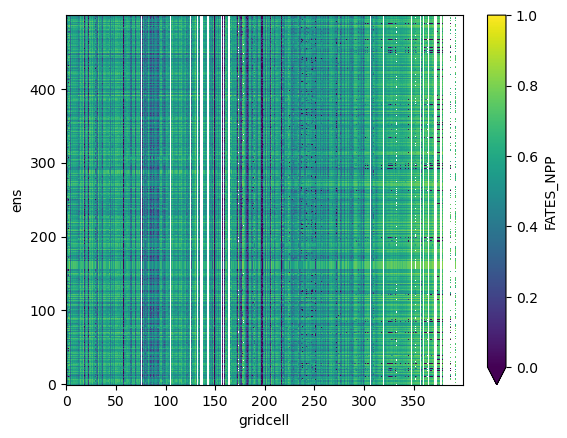

In [17]:
if(read_model_output==1):
    npp=dsc.FATES_NPP
    
    cue = npp.copy(deep=True) 
    print(cue)
    cue=cue.mean(dim='time')
    cue=np.divide(cue,dsc.FATES_GPP.mean(dim='time'))
    cue.to_netcdf(cuedatafile)
 
    cue.plot(vmin=0,vmax=1)

In [18]:
cuematrix=np.divide((dsc['FATES_NPP'].mean('time') ),(dsc['FATES_GPP'].mean('time') ))

In [19]:
if(read_model_output==1):
    print(ldatafile)
    laimatrix=(dsc['FATES_LAI'].mean('time') )
    laimatrix.to_netcdf(ldatafile)  

lai_output_10.nc


In [20]:
l=xr.open_dataset(ldatafile)
print(l)

<xarray.Dataset>
Dimensions:    (ens: 500, gridcell: 400)
Dimensions without coordinates: ens, gridcell
Data variables:
    FATES_LAI  (ens, gridcell) float32 ...


In [21]:
n=xr.open_dataset(nppdatafile)
print(n)

<xarray.Dataset>
Dimensions:    (ens: 500, gridcell: 400)
Dimensions without coordinates: ens, gridcell
Data variables:
    FATES_NPP  (ens, gridcell) float32 ...


In [22]:
n=xr.open_dataset(nppdatafile)
print(n)

<xarray.Dataset>
Dimensions:    (ens: 500, gridcell: 400)
Dimensions without coordinates: ens, gridcell
Data variables:
    FATES_NPP  (ens, gridcell) float32 ...


In [23]:
c=xr.open_dataset(cuedatafile)
print(c)

<xarray.Dataset>
Dimensions:    (ens: 500, gridcell: 400)
Dimensions without coordinates: ens, gridcell
Data variables:
    FATES_NPP  (ens, gridcell) float32 ...


### 7 Read in Adrianna's ILAMB data file

In [24]:
import pandas as pd

ilamb_file='ILAMB_sparsegrid_data.csv'

ilamb_data = pd.read_csv(ilamb_file)
lat_lon_array = ilamb_data[['lat', 'lon']].values

lai_values = ilamb_data.loc[ilamb_data['variable'] == 'lai']


lai_values = ilamb_data.loc[ilamb_data['variable'] == 'lai']
lai_values_modis = ilamb_data.loc[ilamb_data['model'] == 'MODIS']
glat=lai_values_modis['lat'].values
glon=lai_values_modis['lon'].values

lai_data_modis = lai_values_modis.loc[:, ['value', 'gridcell','lat','lon']]
lai_data_modis_sorted = lai_data_modis.sort_values(by='gridcell')
lai_data_modis_array = lai_data_modis_sorted.to_numpy()

lai_values_avhrr = ilamb_data.loc[ilamb_data['model'] == 'AVH15C1']
lai_data_avhrr = lai_values_avhrr.loc[:, ['value', 'gridcell','lat','lon']]
lai_values_avhrr = lai_values_avhrr.loc[:, ['value', 'gridcell','lat','lon']]

lai_data_avhrr = lai_values_avhrr.loc[:, ['value', 'gridcell','lat','lon']]
lai_data_avhrr_sorted = lai_data_avhrr.sort_values(by='gridcell')
lai_data_avhrr_array = lai_data_avhrr_sorted.to_numpy()
print(np.shape(glat))


(400,)


### 8. Read in gridcells dominated by each PFT

In [25]:
import pandas as pd
sg_pftmap_file='../sparse_grid_files/grid_pfts_dominant.csv'
sg_data = pd.read_csv(sg_pftmap_file)
pfts=[0, 1, 2, 7,8,9,10,11]
gcells_pft=['.']*(max(pfts)+1)
for p in pfts: # pfts to select. 
    pftname=sg_data['pft'].values[p]
    gcl=sg_data['gridcells'].loc[sg_data['pft']== pftname].values[0]
    gc_list = gcl.split(',')
    gcells = [int(num) for num in gc_list]
    gcells_pft[p]=gcells
# remove the TBEF gridcells with zero LAI. These are not relevant to the fitting process. 
print(gcells_pft[0])
betlai=lai_data_modis_array[gcells_pft[0],0]
print(betlai)
gcells_pft[0].pop(4)
gcells_pft[0].pop(10)
gcells_pft[0].pop(9)
betlai=lai_data_modis_array[gcells_pft[0],0]
print(betlai)

[59, 66, 75, 82, 84, 86, 87, 88, 92, 93, 113, 123, 134]
[3.9783148  4.85256377 4.37602256 4.46207183 0.         4.71636288
 2.23690402 4.30946843 3.9978255  3.60916557 0.         0.
 3.63237013]
[3.9783148  4.85256377 4.37602256 4.46207183 4.71636288 2.23690402
 4.30946843 3.9978255  3.60916557 3.63237013]


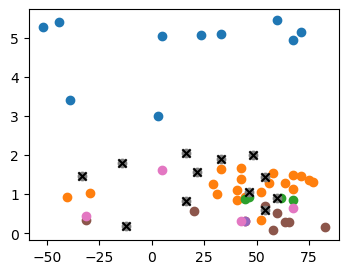

In [26]:
fig, axes = plt.subplots(figsize=(4, 3))
for p in pfts:
    plt.scatter(glat[gcells_pft[p]],lai_data_avhrr_array[gcells_pft[p],0])
plt.scatter(glat[gcells],lai_data_avhrr_array[gcells,0],color='black',marker='x')

### 9. Plot out the ensemble space of all gridcells wrt LAI data


In [27]:
plot_range=0

if(plot_range==1):    
    laiens=l.FATES_LAI
    laiens_s = np.swapaxes(laiens, 0, 1)
    #laiens_t = np.transpose(laiens)
    fig, axes = plt.subplots(nrows=7, ncols=1, figsize=(27, 16))
    plt.subplots_adjust(wspace=0.1, hspace=0.15)
    
    for r in range(0,8):   
       # axes[r, 0].set_title(var,fontsize=20)   
        for e in range(len(laiens)):   
            axes[r-1].scatter(lai_data_modis_array[(r-1)*50:r*50,1],laiens_s[(r-1)*50:r*50,e],color='grey',s=8)
        axes[r-1].scatter(lai_data_modis_array[(r-1)*50:r*50,1], lai_data_avhrr_array[(r-1)*50:r*50,0],color='blue',s=100,marker='x')        
        axes[r-1].scatter(lai_data_modis_array[(r-1)*50:r*50,1], lai_data_modis_array[(r-1)*50:r*50,0],color='red',s=100,marker='x')        
        axes[r-1].set_ylabel('LAI', fontsize=18) 
        axes[r-1].set_ylim([0,6]) 
    axes[r-1].set_xlabel('Gridcell', fontsize=20) 
    plt.savefig(figdir+'/range_vs_data_'+fatesvar+'_y'+str(ychoose)+'Nens_'+str(ensN)+'.png',bbox_inches='tight')  
    plt.show()

### 10.1 Plot the LAI ensemble space per PFT

3
lais (400, 500)


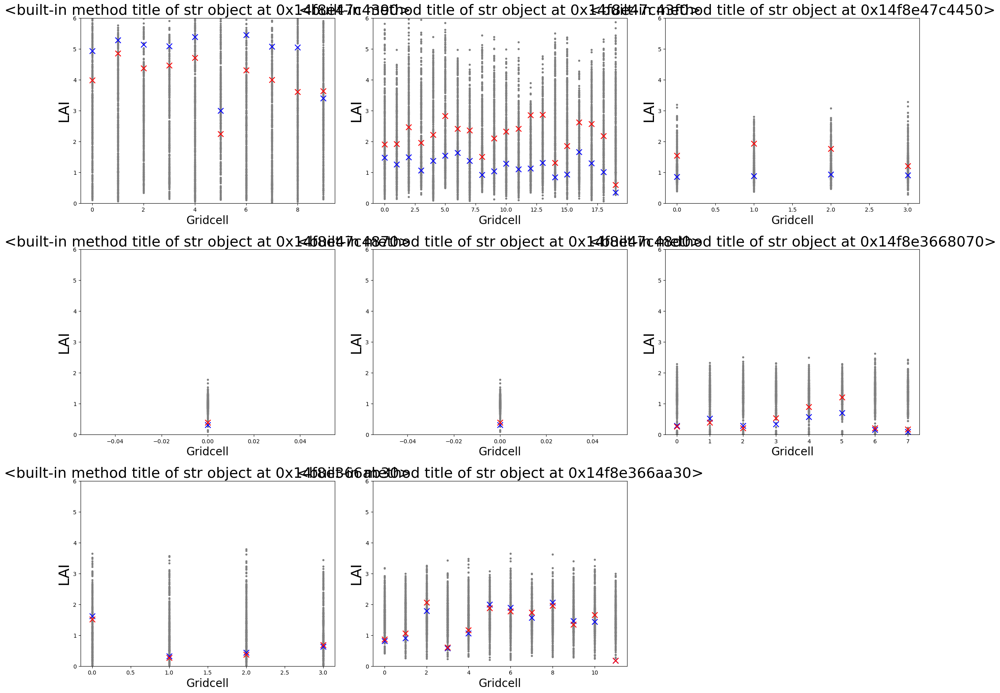

In [28]:
plot_range=1
ncls=ncls_pft
rw=int(len(pfts)/ncls)+1
print(rw)

if(plot_range==1): 
    fig, axes = plt.subplots(nrows=rw, ncols=ncls, figsize=(27, 21))
    plt.subplots_adjust(wspace=0.15, hspace=0.25)

    laiens=l.FATES_LAI
    laiens_s = np.swapaxes(laiens, 0, 1)
    print('lais',np.shape(laiens_s))
    axcount=0
    for p in pfts: # pfts to select. 
        gcells=gcells_pft[p]

        xvar = [list(range(len(gcells))) for _ in range(len(laiens))]
        if len(gcells) >0 :
            row = axcount //ncls
            col = axcount % ncls   
            axcount=axcount+1
            laiens=l.FATES_LAI

           # axes[r, 0].set_title(var,fontsize=20)   
            lai_data_modis_array[gcells,0]   
            axes[row,col].scatter(xvar,laiens_s[gcells,:],color='grey',s=8)
            axes[row,col].scatter(range(len(gcells)), lai_data_avhrr_array[gcells,0],color='blue',s=100,marker='x')        
            axes[row,col].scatter(range(len(gcells)), lai_data_modis_array[gcells,0],color='red',s=100,marker='x')        
            axes[row,col].set_ylabel('LAI', fontsize=26) 
            axes[row,col].set_ylim([0,6]) 
            axes[row,col].set_title(sg_data['pft'].values[p].title, fontsize=26) 
            axes[row,col].set_xlabel('Gridcell', fontsize=20)
    while axcount < rw*ncls:
        row = axcount //ncls
        col = axcount %ncls
        axes[row, col].remove()
        axcount += 1
    plt.savefig(figdir+'/range_vs_data_lai'+fatesvar+'_y'+str(ychoose)+'Nens_'+str(ensN)+'.png',bbox_inches='tight')  
    plt.show()


In [29]:
cue_pft_mean=np.zeros(max(pfts)+1)
cue_pft_std=np.zeros(max(pfts)+1)
for p in pfts: # pfts to select. 
    gcells=gcells_pft[p]
    cue_pft_mean[p]=0.46
    cue_pft_std[p]=0.11

cue_pft_mean[0]=0.44
cue_pft_mean[1]=0.45
cue_pft_mean[2]=0.44

print(cue_pft_mean)
# EBT 0.44 ± 0.11
# DBT 0.50 ± 0.13    
# ENT 0.45 ± 0.11

[0.44 0.45 0.44 0.   0.   0.   0.   0.46 0.46 0.46 0.46 0.46]


3


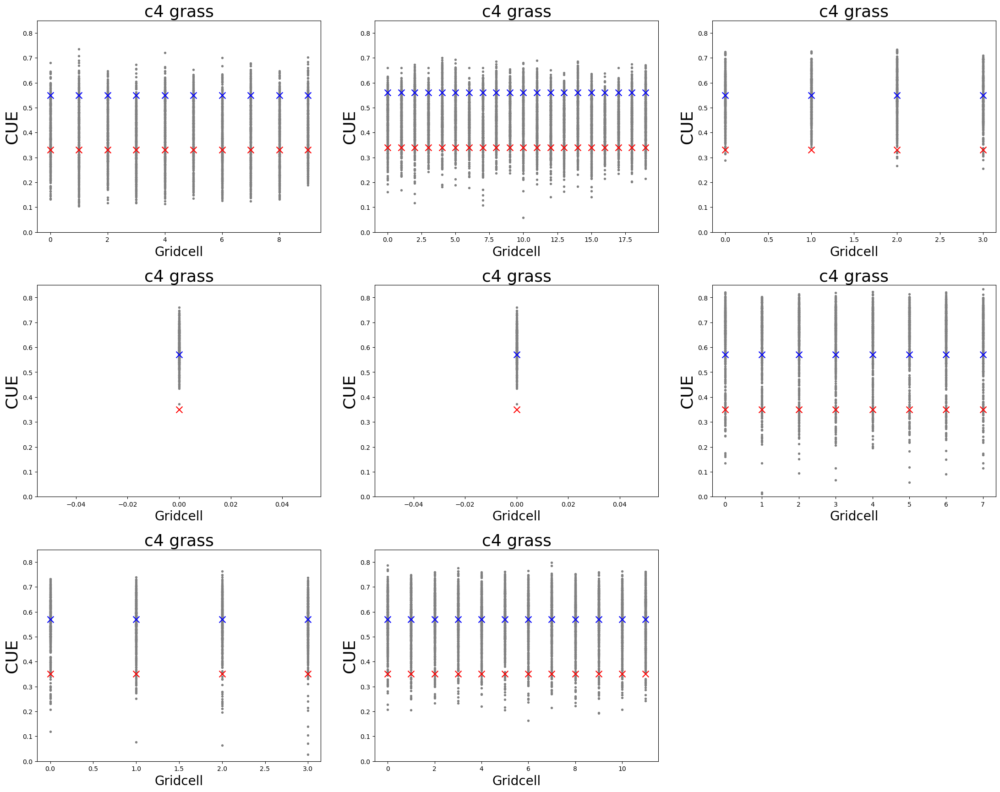

In [30]:
plot_range=1
ncls=ncls_pft
rw=int(len(pfts)/ncls)+1
print(rw)


if(plot_range==1): 
    fig, axes = plt.subplots(nrows=rw, ncols=ncls, figsize=(27, 21))
    plt.subplots_adjust(wspace=0.19, hspace=0.25)

    axcount=0
    for p in pfts: # pfts to select. 

        gcells=gcells_pft[p]
        if len(gcells) >0 :
            xvar = [list(range(len(gcells))) for _ in range(len(laiens))]
            row = axcount //ncls
            col = axcount % ncls   
            axcount=axcount+1
            cueens=c.FATES_NPP
            cueens_s = np.swapaxes(cueens, 0, 1)
            #laiens_t = np.transpose(laiens)
           # axes[r, 0].set_title(var,fontsize=20)   
            lai_data_modis_array[gcells,0]
            cuemin=cue_pft_mean[p]-cue_pft_std[p]
            cuemax=cue_pft_mean[p]+cue_pft_std[p]  
            axes[row,col].scatter(xvar,cueens_s[gcells,:],color='grey',s=8)
            axes[row,col].scatter(range(len(gcells)), lai_data_avhrr_array[gcells,0]*0+cuemin,color='red',s=100,marker='x')        
            axes[row,col].scatter(range(len(gcells)), lai_data_avhrr_array[gcells,0]*0+cuemax,color='blue',s=100,marker='x')        
            axes[row,col].set_ylabel('CUE', fontsize=26) 
            axes[row,col].set_ylim([0,0.85]) 
            axes[row,col].set_title(pftname, fontsize=26) 
            axes[row,col].set_xlabel('Gridcell', fontsize=20)
    while axcount < rw*ncls:
        row = axcount //ncls
        col = axcount %ncls
        axes[row, col].remove()
        axcount += 1
    plt.savefig(figdir+'/range_vs_data_cue_'+fatesvar+'_y'+str(ychoose)+'Nens_'+str(ensN)+'.png',bbox_inches='tight')  
    plt.show()


### Find mean LAI per PFT

In [31]:
modis_lai_pft=np.zeros(max(pfts)+1)
avhrr_lai_pft=np.zeros(max(pfts)+1)   
for p in pfts: # pfts to select. 
    gcells=gcells_pft[p]
    modis_lai_pft[p]=np.mean(lai_data_modis_array[gcells,0])
    avhrr_lai_pft[p]=np.mean(lai_data_avhrr_array[gcells,0])
print(modis_lai_pft)

[4.01710695 2.1630972  1.60666975 0.         0.         0.
 0.         0.39712667 0.39712667 0.48546399 0.71036687 1.35780781]


### Find mean CUE per PFT

### 10 Deal with any nans in the model output

In [32]:

nan_indices = l.FATES_LAI.isnull().any(dim='ens')

# Use the where method to filter out NaN values along the 'time' dimension
filtered_data = l.FATES_LAI.where(~nan_indices, drop=True)
lnonan=filtered_data.fillna(999)

lnonan=l.FATES_LAI

nan_indices = c.FATES_NPP.isnull().any(dim='ens')

# Use the where method to filter out NaN values along the 'time' dimension
filtered_data = c.FATES_NPP.where(~nan_indices, drop=True)
cnonan=filtered_data.fillna(999)

cnonan=c.FATES_NPP

### 11.  Make Function to map out parameter space

In [33]:
def map_param_space(g,vnonan):
    ncls=ncls_param
    rw=int(len(lhc_vars)/ncls)+1

    fig, axes = plt.subplots(nrows=rw, ncols=ncls, figsize=(27, 16))
    plt.subplots_adjust(wspace=0.1, hspace=0.15)
    fig.suptitle('Impacts of parameter variation on ' + fatesvar,y=0.93, fontsize=26)
    p=-1
    axcount=0
    timemean=dsc[fatesvar].mean('time')
  
    X=x_array 
    yall=vnonan[:,g]
    yall=yall[0:len(x_array)]   
    
    print(yall.shape,np.shape(x_array))
    
    for i, var in enumerate(parlist):
        p=p+1
     #   print(p)
        row = axcount //ncls
        col = axcount % ncls        
        axcount=axcount+1    
        #print(np.shape(paramv), fates_output_data.shape)
        axes[row, col].set_title(var,fontsize=20)    
        diffplot=axes[row, col].scatter(x_array[:,i],yall)
        if(row>1):
            axes[row, col].set_yticklabels([], fontsize=18) 
        if(col>1):
            axes[row, col].set_yticklabels([], fontsize=18) 
        #axes[row, col].set_ylim([0,yl]) 
    while axcount < rw*ncls:
        row = axcount //ncls
        col = axcount %ncls
        axes[row, col].remove()
        axcount += 1
    
    plt.savefig(figdir+'x_vs_y'+fatesvar+'_y'+str(ychoose)+'_g'+str(g)+'.png',bbox_inches='tight')  
    plt.show()

### 13. Make different types of statistical model  

### 13.1 Random forest

In [34]:
# Load a sample dataset (Boston housing dataset)
def random_forest(g,fgs,feat, axes, row, col,multp,vnonan):
    yall=vnonan[:,g]

    if np.ndim(yall)==2:     
        yall=np.mean(yall,1)
    nan_indices = yall.isnull()
    yall[np.isnan(yall)] = np.mean(yall)
    yall=yall[0:len(x_array)]
    X=x_array[0:len(yall),:]
    print(np.shape(X),np.shape(yall))
    
    # Split the dataset into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X,yall, test_size=0.2, random_state=42)
    mask = np.where(np.isinf(y_train))
    y_train[mask]=0.5
    # Create a random forest regressor model
    rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
    
    # Fit the model to the training data
    rf_model.fit(X_train, y_train)
    rf_models.append(rf_model)

    # Make predictions on the testing data
    y_pred = rf_model.predict(X_test)
    if(fgs==1 ):
        if(multp==1):
            ax=axes[row,col]
            print('ax',row,col)
        else:
            ax=axes
       # map_param_space(g)
        #fig = plt.figure()
        ax.scatter(y_test,y_pred,color='blue',s=20,label='Random Forest')
        ax.plot([0,max(y_pred)],[0,max(y_pred)],color='black')
            #plt.scatter(tr_predictions,y)
        #axes[row,col].title('g='+str(g)+' Lat:'+str(round(glat[g], 2))+' Lon:'+str(round(glon[g], 2)))

        ax.set_xlabel(fatesvar+' process model')
        ax.set_ylabel(fatesvar+' surrogate')
    r_squared = stats.pearsonr(y_pred, y_test)[0] ** 2
    if(feat==1):
        feature_importances = rf_model.feature_importances_
    
    # Create a DataFrame to display the feature importances
        #feature_importances_df = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importances})
        #feature_importances_df = feature_importances_df.sort_values(by='Importance', ascending=False)
        feature_importances_df = pd.DataFrame({'Feature Importance': feature_importances})
        feature_importances_df['FeatureIndex'] = range(0, len(feature_importances_df) )

        feature_importances_df = feature_importances_df.sort_values(by='Feature Importance', ascending=False)
    
        # Display the dominant factors
        #print(feature_importances_df.FeatureIndex.iloc[1:4])
        featimp=feature_importances_df.FeatureIndex.iloc[0:4]
    return r_squared,featimp


### 13.2 Linear Regression

In [35]:
def linear_regression(g,fgs, axes, row, col,vnonan):
    yall=vnonan[:,g]
    if np.ndim(yall)==2:   
        yall=np.mean(yall,1)
    nan_indices = yall.isnull()
    yall[np.isnan(yall)] = np.mean(yall)   
    X=x_array
    X_train, X_test, y_train, y_test = train_test_split(X,yall, test_size=0.2, random_state=42)
    
    model = sm.OLS(y_train, X_train).fit()  # Fit the multivariate linear regression model
   # print(model.summary())
    predictions = model.predict(X_test)
    tr_predictions = model.predict(X)
    if(fgs==1):
        #map_param_space(g)
        axes[row,col].scatter(y_test,predictions,color='green',label='Linear Regression')
        #plt.scatter(tr_predictions,y)
    residuals = model.resid

# Calculate the standard deviation of predictions
  #  std_dev_predictions = residuals.std()
  #  rel_dev=np.divide(std_dev_predictions,np.mean(y))

    r_squared = stats.pearsonr(predictions, y_test)[0] ** 2
    return r_squared

### 13.3 Gaussian Process emulator

In [36]:
def make_emulator_for_point(g,fgs, axes, row, col,vn):
    yall=vn[:,g]

    if np.ndim(yall)==2:     
        yall=np.mean(yall,1)
    nan_indices = yall.isnull()
    yall[np.isnan(yall)] = np.mean(yall)
    yall=yall[0:len(x_array)]
    X=x_array[0:len(yall),:]
    print(np.shape(X),np.shape(yall))
    
    # Split the dataset into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X,yall, test_size=0.2, random_state=42)
    mask = np.where(np.isinf(y_train))
    y_train[mask]=0.5    
    kernel = 1 * RBF(length_scale=1.0, length_scale_bounds=(1e-2, 1e2))
    gp = GaussianProcessRegressor(kernel=kernel, n_restarts_optimizer=10)
    y_pred =gp.fit(X_train, y_train)
    test_prediction, std_prediction = gp.predict(X_test, return_std=True)
    #r2 = r2_score(ytest, test_prediction) 
    
    if(np.max(test_prediction)==0):
        print('emulator fail')
    else:
        print(np.mean(test_prediction))
    

    if(fgs==1 ):
        if(multp==1):
            ax=axes[row,col]
            print('ax',row,col)
        else:
            ax=axes
            
        ax.scatter(y_test,test_prediction, color='red', marker='o',label='GP emulator')
        ax.legend()
        #ax.scatter(test_prediction,ytest)
        #ax.set_xlabel('LAI emulator')
        #ax.set_ylabel('LAI FATES')

    r_squared = stats.pearsonr(test_prediction, y_test)[0] ** 2
    return r_squared
    

### 14.  Run emulators

In [37]:
# Make empty lists for statistical models
rf_st=np.zeros(355)
lr_st=np.zeros(355)
gp_st=np.zeros(355)

### 14.1 Plot a single emulator

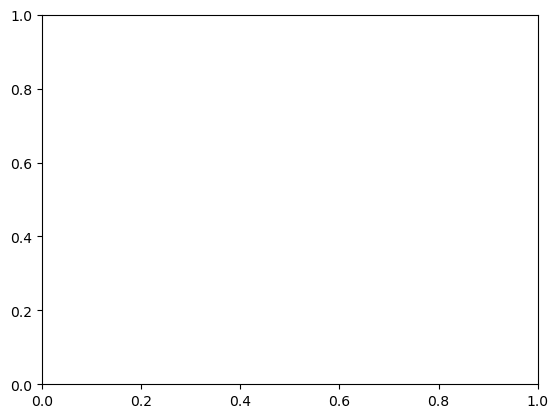

In [38]:
fig=  plt.figure()
rf_models = []
multp=0
plt.subplots_adjust(wspace=0.1, hspace=0.15)
axes = fig.add_subplot(1, 1, 1)  
# Adding a single subplot to the figure
#random_forest(gcells,1,1, axes, 1, 1,multp,cnonan)
#make_emulator_for_point(g,1, axes, row, col,cnonan)


### 14.2 Plot the PFT specific emulators  in different subplots

(500, 10) (500,)
ax 0 0
(500, 10) (500,)
0.3803935303559323
ax 0 0
(500, 10) (500,)
ax 0 1
(500, 10) (500,)
0.4484696059620616
ax 0 1
(500, 10) (500,)
ax 0 2
(500, 10) (500,)
0.5390145173516626
ax 0 2
(500, 10) (500,)
ax 1 0
(500, 10) (500,)
0.5992863147179819
ax 1 0
(500, 10) (500,)
ax 1 1
(500, 10) (500,)
0.599286314683743
ax 1 1
(500, 10) (500,)
ax 1 2
(500, 10) (500,)
0.5846738297620258
ax 1 2
(500, 10) (500,)
ax 2 0
(500, 10) (500,)
0.5479912069488374
ax 2 0
(500, 10) (500,)
ax 2 1
(500, 10) (500,)
0.5544284018707403
ax 2 1


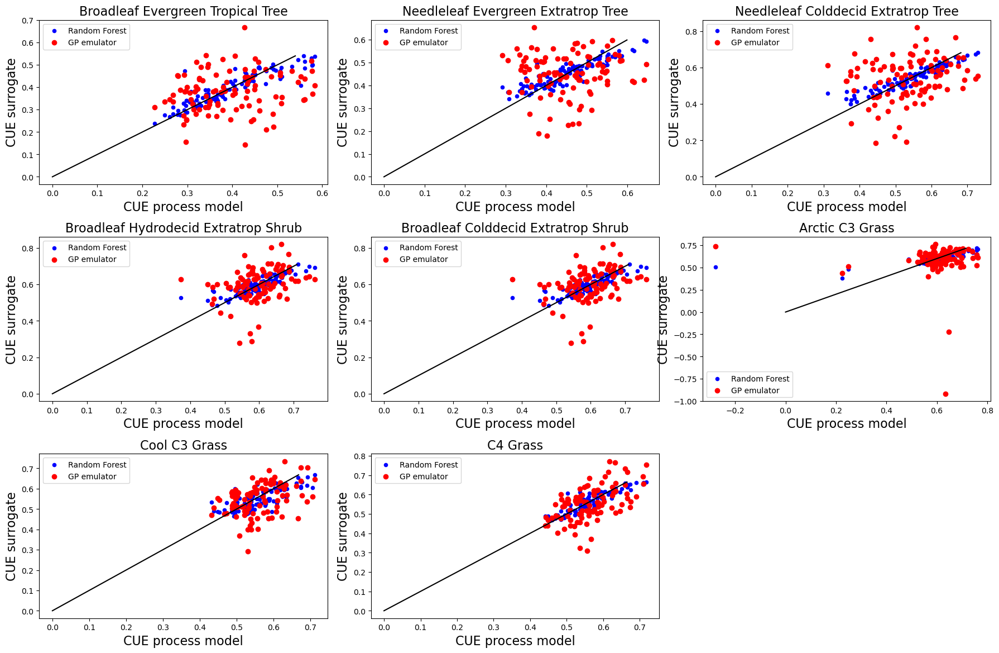

(500, 10) (500,)
ax 0 0
(500, 10) (500,)
2.213331889703784
ax 0 0
(500, 10) (500,)
ax 0 1
(500, 10) (500,)
1.4972940962117764
ax 0 1
(500, 10) (500,)
ax 0 2
(500, 10) (500,)
1.0236208880095636
ax 0 2
(500, 10) (500,)
ax 1 0
(500, 10) (500,)
0.9835582608173905
ax 1 0
(500, 10) (500,)
ax 1 1
(500, 10) (500,)
0.9835582617913741
ax 1 1
(500, 10) (500,)
ax 1 2
(500, 10) (500,)
1.1847341055508664
ax 1 2
(500, 10) (500,)
ax 2 0
(500, 10) (500,)
1.087227533308486
ax 2 0
(500, 10) (500,)
ax 2 1
(500, 10) (500,)
1.468348135726834
ax 2 1


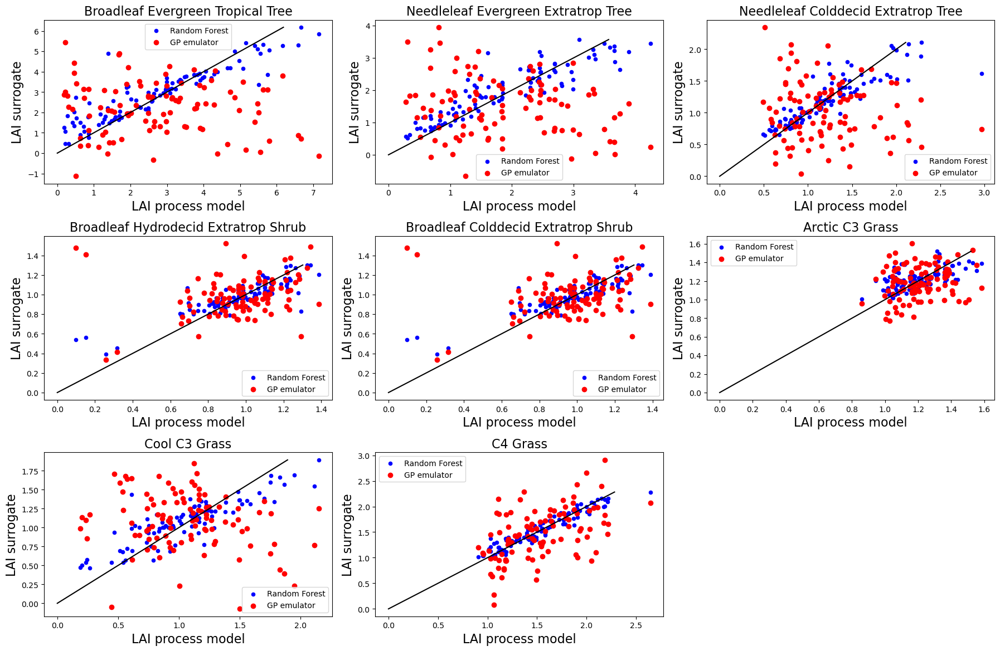

In [39]:
ncls=ncls_pft
rw=int(len(gcells)/ncls)+1
feat_importance = np.zeros([len(pfts),4,2], dtype=int)
vnonan=[cnonan,lnonan]
for v, vn in enumerate(vnonan): 
    fig, axes = plt.subplots(nrows=rw, ncols=ncls, figsize=(22, 24))
    plt.subplots_adjust(wspace=0.15, hspace=0.32)
    multp=1
    rf_models = []
    rf_st=np.zeros(max(pfts))
    axcount=0
    for i in range(len(pfts)):
        p=pfts[i]
        row = axcount //ncls
        col = axcount % ncls   
        axcount=axcount+1
        rf_st[i],feat_importance[i,:,v]=random_forest(gcells_pft[p],1,1, axes, row, col,multp,vn)
        make_emulator_for_point(gcells_pft[p],1, axes, row, col,vn)

        axes[row,col].set_xlabel(vars_bm[v]+' process model',fontsize=16)
        axes[row,col].set_ylabel(vars_bm[v]+' surrogate',fontsize=16)
        axes[row,col].set_title(sg_data['pft'].values[p].title(),fontsize=16)
    
    while axcount < rw*ncls:
        row = axcount //ncls
        col = axcount %ncls
        axes[row, col].remove()
        axcount += 1

    plt.savefig(figdir+'/PFT_level_RF_fit_'+vars_bm[v]+'_y'+str(ychoose)+'Nens_'+str(ensN)+'.png',bbox_inches='tight')  
    plt.show()
    if(v==1):        
        rf_models_lai = rf_models
    else:
        rf_models_cue = rf_models
        

In [40]:
print(feat_importance[1,1,1])

4


### 14.3 Plot gridcell specific emulators (for a given PFT) in differenet subplots

In [41]:
plot_gcell_fit=0
target_pft=0
vnonan=cnonan
if plot_gcell_fit==1 :
    multp=0
    ncls=3
    rw=int(len(gcells)/ncls)+1
    print(rw)
    fig, axes = plt.subplots(nrows=rw, ncols=ncls, figsize=(27, 21))
    plt.subplots_adjust(wspace=0.1, hspace=0.15)
    
    do_all_models=1
    if(do_all_models==1):
        rf_models = []
        feat_importance = np.zeros([355,4,2], dtype=int)
        axcount=0
        for g in gcells:
            row = axcount //ncls
            col = axcount % ncls   
            axcount=axcount+1
            rf_st[g],feat_importance[g,:,v]=random_forest(g,1,1, axes, row, col,multp,vnonan)
            lr_st[g]=linear_regression(g,1, axes, row, col)
            gp_st[g]=make_emulator_for_point(g,1, axes, row, col)
            print('g='+str(g),'rf:',rf_st[g],'l1:',lr_st[g],'gp:',gp_st[g])
        plt.savefig(figdir+'/emulator_test_'+str(ensN)+'_'+fatesvar+'_p'+str(p)+'.png', bbox_inches='tight')
        plt.show()

    else:
        rf_models = []
        feat_importance = np.zeros([355,4], dtype=int)
        for g in gcells:
            rf_st[g],feat_importance[g,:]=random_forest(g,0,1)
            print(feat_importance[g,:],lhc_vars[feat_importance[g,0]],
                 lhc_vars[feat_importance[g,1]],
                 lhc_vars[feat_importance[g,2]])
    

### 15. Make a large hypercube encompassing the whole parameter space 

In [42]:
num_samples=150000
num_variables = len(lhc_vars)
hypercube = np.zeros((num_samples, num_variables))
for i in range(num_variables):
    hypercube[:, i] = np.random.permutation(np.linspace(0, 1, num_samples))

hypercube_scaled=np.zeros((num_samples, num_variables))
#for i  in range(5):
for i, var in enumerate(lhc_vars):
    mx=np.max(x_array[:,i])
    mn=np.min(x_array[:,i])
    for e in range(num_samples):
        hypercube_scaled[e,i]=(hypercube[e,i]*(mx-mn))+mn
Xdense=hypercube_scaled
print('hypercube shape',np.shape(Xdense))

hypercube shape (150000, 10)


### 16 Find simulations with acceptable LAI and CUE

In [43]:
y_pred_noise_i_lai = []
y_pred_noise_i_cue = []
for i in range(len(pfts)):
    g=gcells[i]     
    y_pred_noise_i_lai.append(rf_models_lai[i].predict(Xdense))
    y_pred_noise_i_cue.append(rf_models_cue[i].predict(Xdense))

    print(i,'mean CUE',np.mean(y_pred_noise_i_cue[i]))

0 mean CUE 0.3910048923056542
1 mean CUE 0.45093288601526815
2 mean CUE 0.5390543445491514
3 mean CUE 0.602659326774458
4 mean CUE 0.602659326774458
5 mean CUE 0.60884655076421
6 mean CUE 0.5472276235922536
7 mean CUE 0.5638427617874759


In [44]:
def find_acceptable_models(rfm,p,pftfit,vartoggle):
    if(vartoggle==1): 
        y_pred_noise=y_pred_noise_i_lai[rfm]
        if(pftfit==1):
            ldmin=min(modis_lai_pft[p],avhrr_lai_pft[p])
            ldmax=max(modis_lai_pft[p],avhrr_lai_pft[p])
            print('ld',p,ldmin,ldmax)
        y_accept=np.where(np.logical_and(y_pred_noise>=ldmin, y_pred_noise<=ldmax))   
        print('accept lai',i,np.shape(y_accept))
    else:
        y_pred_noise=y_pred_noise_i_cue[rfm]
        cdmin=cue_pft_mean[p]-0.5*cue_pft_std[p]
        cdmax=cue_pft_mean[p]+0.5*cue_pft_std[p]
        print('cd',cdmin,cdmax)
        y_accept=np.where(np.logical_and(y_pred_noise>=cdmin, y_pred_noise<=cdmax))   
        print('accept cue',i,np.shape(y_accept))
        
    return y_accept


In [45]:
pftfit=1
print(modis_lai_pft)
print(cue_pft_mean)
accept_lai_i = []
accept_cue_i = []
accept_both_i = []
if(pftfit==1):
    for rfm in range(len(pfts)):        
        p=pfts[rfm]   
        print(rfm,p)
        accept_lai_i.append(find_acceptable_models(rfm,p,pftfit,1))
        accept_cue_i.append(find_acceptable_models(rfm,p,pftfit,2))
        
else: # gridcell fit  
    for rfm in range(len(gcells)):
        g=gcells[i]        
        accept_lai_i.append(find_acceptable_models(rfm,g,pftfit))  

[4.01710695 2.1630972  1.60666975 0.         0.         0.
 0.         0.39712667 0.39712667 0.48546399 0.71036687 1.35780781]
[0.44 0.45 0.44 0.   0.   0.   0.   0.46 0.46 0.46 0.46 0.46]
0 0
ld 0 4.017106948440324 4.778851745056542
accept lai 7 (1, 16821)
cd 0.385 0.495
accept cue 7 (1, 64781)
1 1
ld 1 1.2033633652257067 2.1630972035964744
accept lai 7 (1, 59664)
cd 0.395 0.505
accept cue 7 (1, 93472)
2 2
ld 2 0.8926908823249665 1.6066697548233826
accept lai 7 (1, 95728)
cd 0.385 0.495
accept cue 7 (1, 38750)
3 7
ld 7 0.31487371794842 0.397126666377788
accept lai 7 (1, 432)
cd 0.405 0.515
accept cue 7 (1, 7985)
4 8
ld 8 0.31487371794842 0.397126666377788
accept lai 7 (1, 432)
cd 0.405 0.515
accept cue 7 (1, 7985)
5 9
ld 9 0.3692829802732685 0.4854639883435774
accept lai 7 (1, 0)
cd 0.405 0.515
accept cue 7 (1, 4280)
6 10
ld 10 0.7103668650054715 0.7535910995586927
accept lai 7 (1, 2314)
cd 0.405 0.515
accept cue 7 (1, 48294)
7 11
ld 11 1.313346522482184 1.357807810754152
accept lai 7

### Draw selected parameter space

In [46]:
def draw_selected_param_space(rfm,p,pftfit,vtoggle):
    ncls=ncls_param
    if ncls==5: 
        tsz=16
        ysz=14
        xsz=14
        ht=16
        psz=9
    if ncls==4 :
        tsz=18
        ysz=18
        xsz=18
        ht=13
        psz=14
    #colors = plt.get_cmap('tab10').colors
    #colors = plt.get_cmap('CSS4_COLORS').colors

    # Choosing a specific color from the Tableau color palette
          
    axcount=0
    y_accept_lai=accept_lai_i[rfm]
    y_accept_cue=accept_cue_i[rfm]
    if(vtoggle==1):
        y_pred_noise  = y_pred_noise_i_lai[rfm]
        fatesens=l.FATES_LAI[0:len(x_array)]
        vlab='LAI'
    else:
        y_pred_noise  = y_pred_noise_i_cue[rfm]
        fatesens=c.FATES_NPP[0:len(x_array)]
        vlab='CUE'

    Xsh=Xdense.shape
    rw=int(len(lhc_vars)/ncls)+1
    fig, axes = plt.subplots(nrows=rw, ncols=ncls, figsize=(22, ht)) 
    pftname=sg_data['pft'].values[p].title()
    fig.suptitle(pftname,fontsize=tsz,y=0.9)
    plt.subplots_adjust(wspace=0.15, hspace=0.35)  
    pftfit=1
    axcount=0

    print('limxmn',np.min(l.FATES_LAI[:,g-1]).values,np.max(fatesens[:,g-1]).values)
    print('ypred',np.min(y_pred_noise),np.max( y_pred_noise))
    for v, var in enumerate(lhc_vars):  
        row = axcount //ncls
        col = axcount % ncls  
        axcount=axcount+1
        axes[row, col].scatter(Xdense[:,v], y_pred_noise, color=chosen_color_all,s=2)    
        # FATES runs
        if(vtoggle==1):#lai on y axis
            axes[row, col].scatter(Xdense[y_accept_cue,v], y_pred_noise[y_accept_cue], color=chosen_color_cue,s=4) 
            axes[row, col].scatter(Xdense[y_accept_lai,v], y_pred_noise[y_accept_lai], color=chosen_color_lai,s=4) 
        else: # lai on y axis            
            axes[row, col].scatter(Xdense[y_accept_lai,v], y_pred_noise[y_accept_lai], color=chosen_color_lai,s=4) 
            axes[row, col].scatter(Xdense[y_accept_cue,v], y_pred_noise[y_accept_cue], color=chosen_color_cue,s=4) 

        
        axes[row, col].scatter(x_array[:,v],  fatesens[:,gcells_pft[p]].mean(dim='gridcell'), s=psz, edgecolor='black',color='black')

        axes[row, col].set_xlabel(lhc_vars_title[v], fontsize=xsz)   
        if(col==0):
            axes[row, col].set_ylabel(vlab, fontsize=ysz)   
            
    while axcount < rw*ncls:
        row = axcount //ncls
        col = axcount %ncls
        axes[row, col].remove()
        axcount += 1


ip 0 0
limxmn 0.25089210271835327 0.7309965491294861
ypred 0.2227012699842453 0.5691678580641747
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_CUE_p0.png


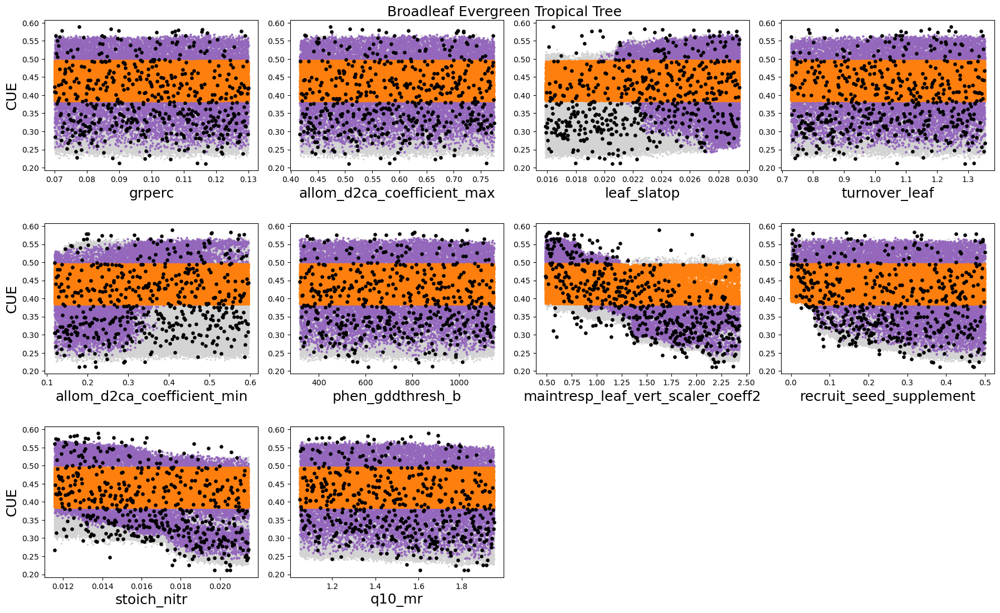

ip 0 0
limxmn 0.25089210271835327 2.0364866256713867
ypred 0.26684324353933336 7.40989547252655
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_LAI_p0.png


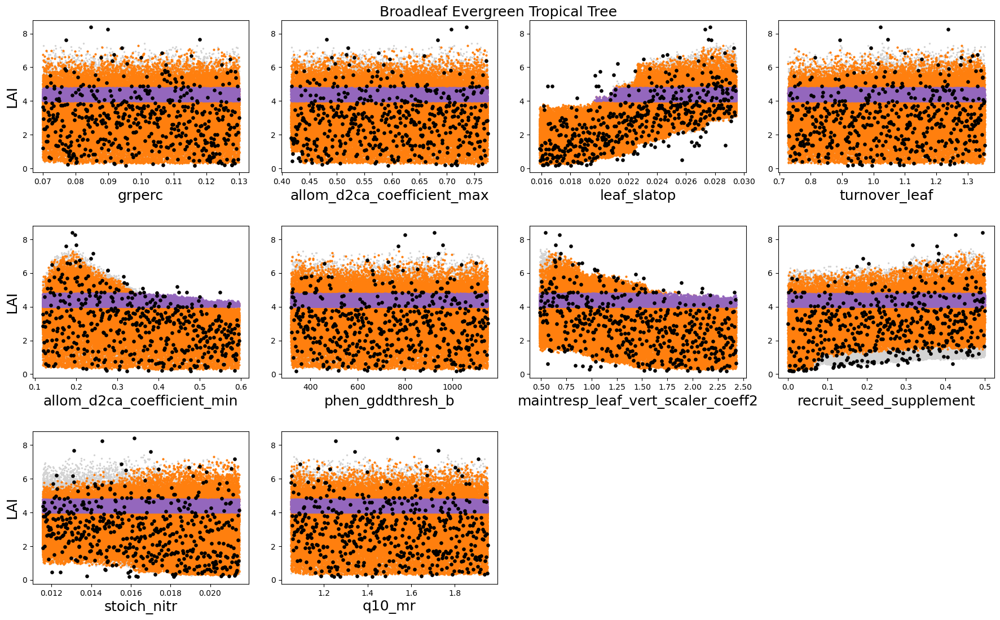

ip 1 1
limxmn 0.25089210271835327 0.7309965491294861
ypred 0.2949596306681633 0.6276559865474701
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_CUE_p1.png


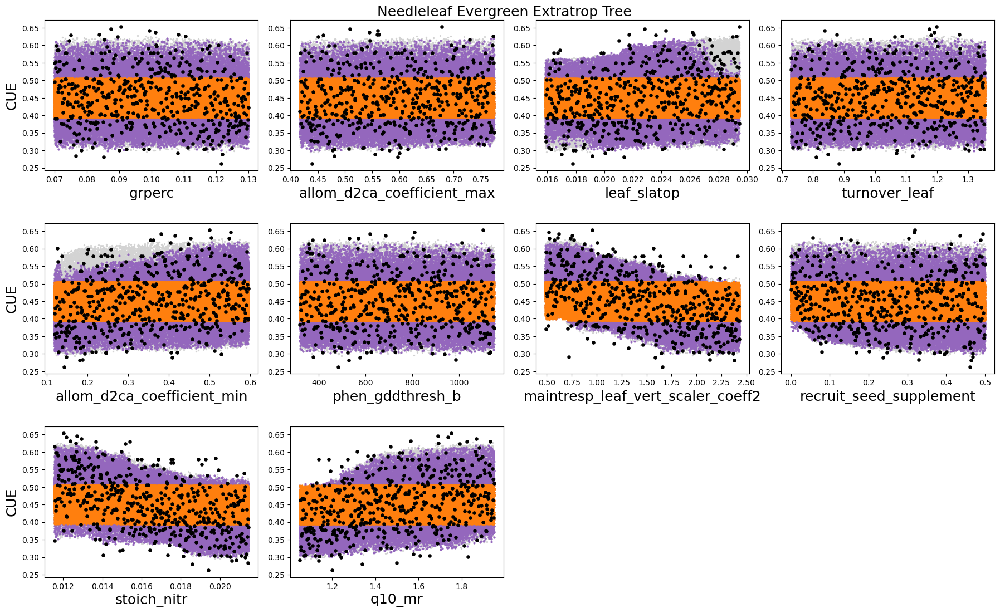

ip 1 1
limxmn 0.25089210271835327 2.0364866256713867
ypred 0.3870599740743637 4.233153088688851
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_LAI_p1.png


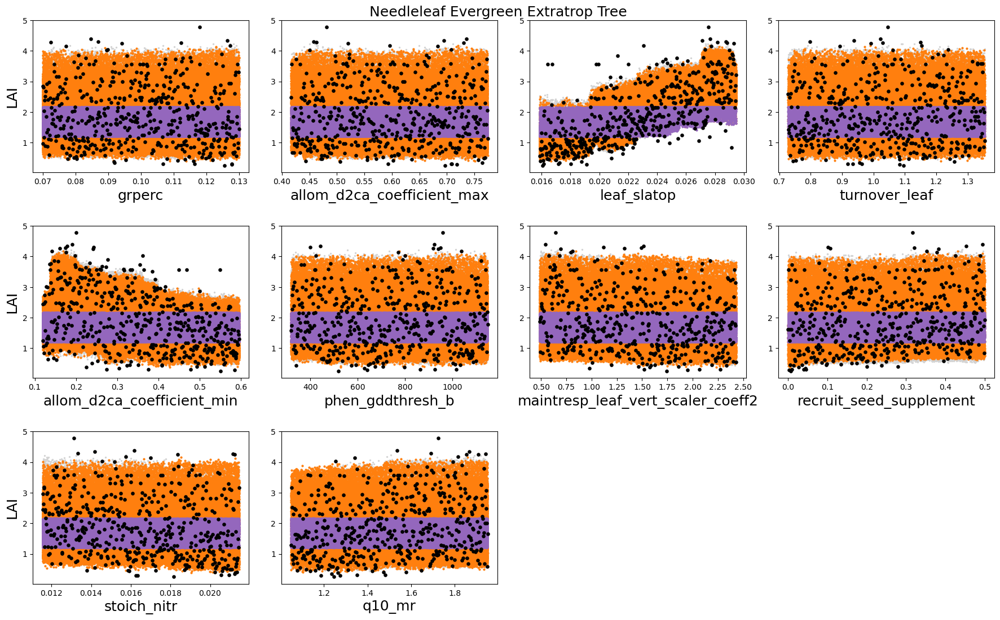

ip 2 2
limxmn 0.25089210271835327 0.7309965491294861
ypred 0.3387343353033066 0.7075249624252319
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_CUE_p2.png


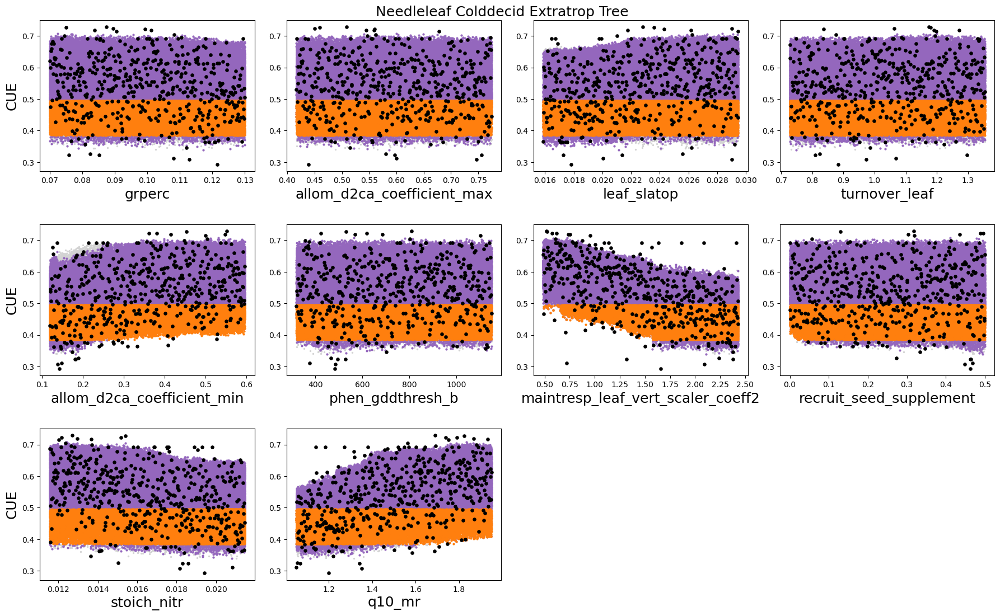

ip 2 2
limxmn 0.25089210271835327 2.0364866256713867
ypred 0.4981562566757202 2.6323635506629945
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_LAI_p2.png


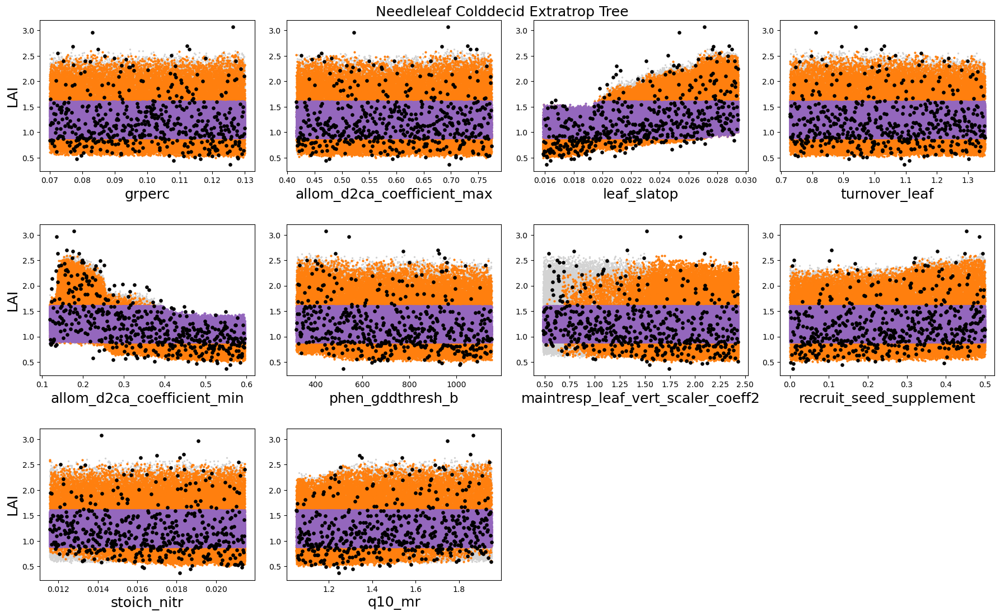

ip 3 7
limxmn 0.25089210271835327 0.7309965491294861
ypred 0.4582437625527382 0.724285472035408
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_CUE_p7.png


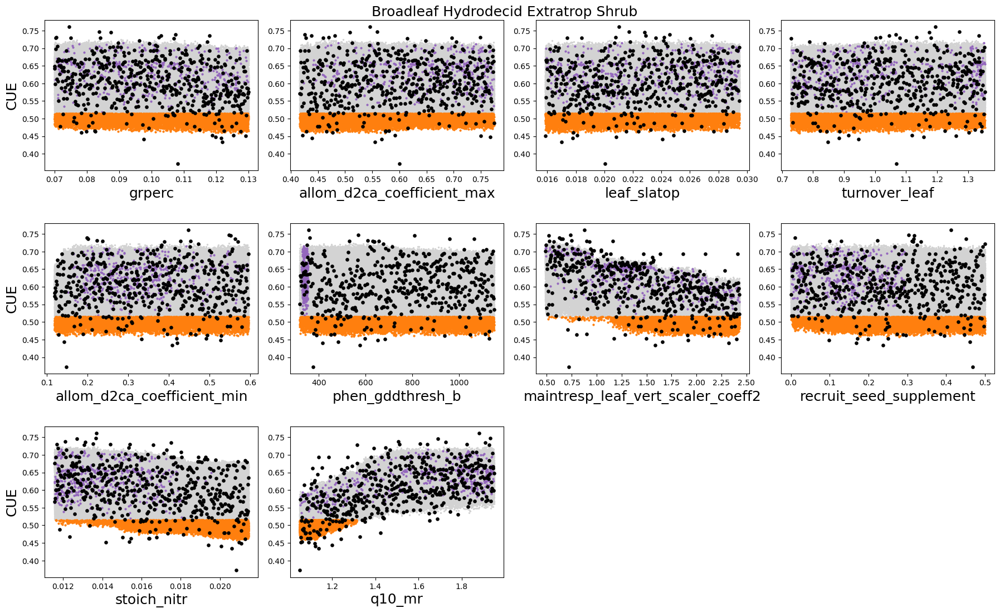

ip 3 7
limxmn 0.25089210271835327 2.0364866256713867
ypred 0.3116873121261597 1.5915878021717071
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_LAI_p7.png


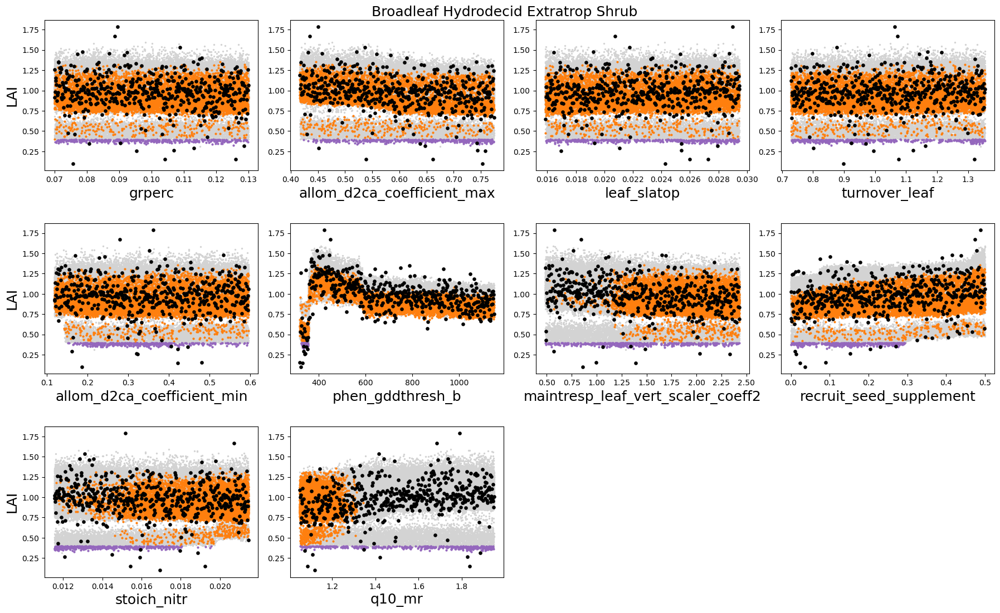

ip 4 8
limxmn 0.25089210271835327 0.7309965491294861
ypred 0.4582437625527382 0.724285472035408
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_CUE_p8.png


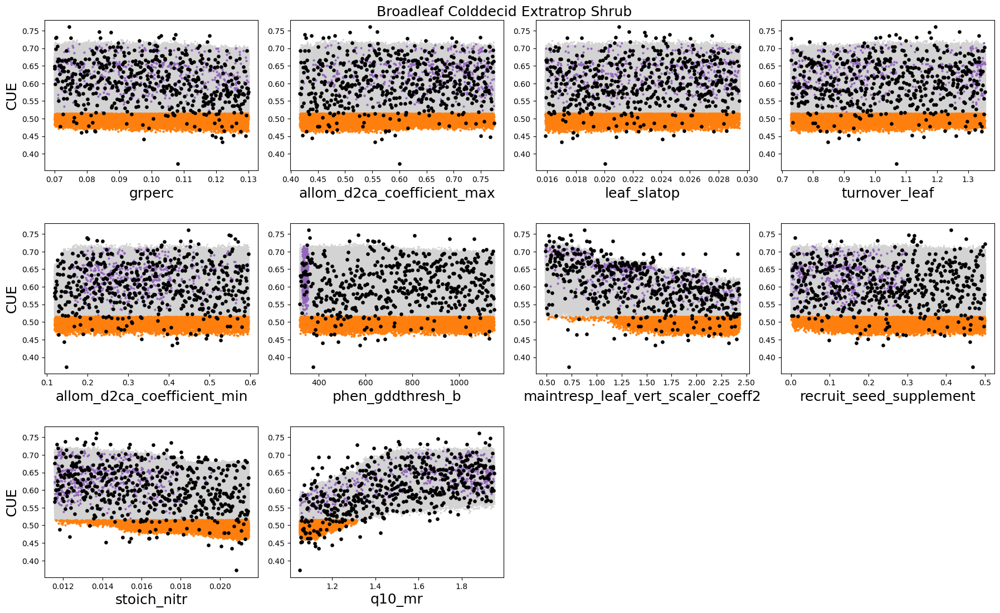

ip 4 8
limxmn 0.25089210271835327 2.0364866256713867
ypred 0.3116873121261597 1.5915878021717071
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_LAI_p8.png


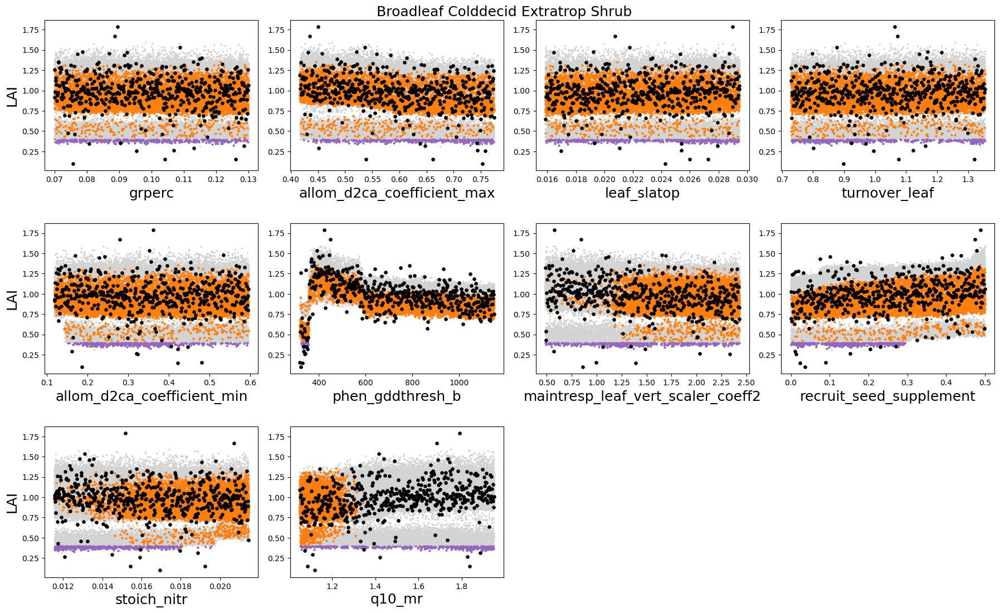

ip 5 9
limxmn 0.25089210271835327 0.7309965491294861
ypred 0.13890857972204684 0.7435655522346497
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_CUE_p9.png


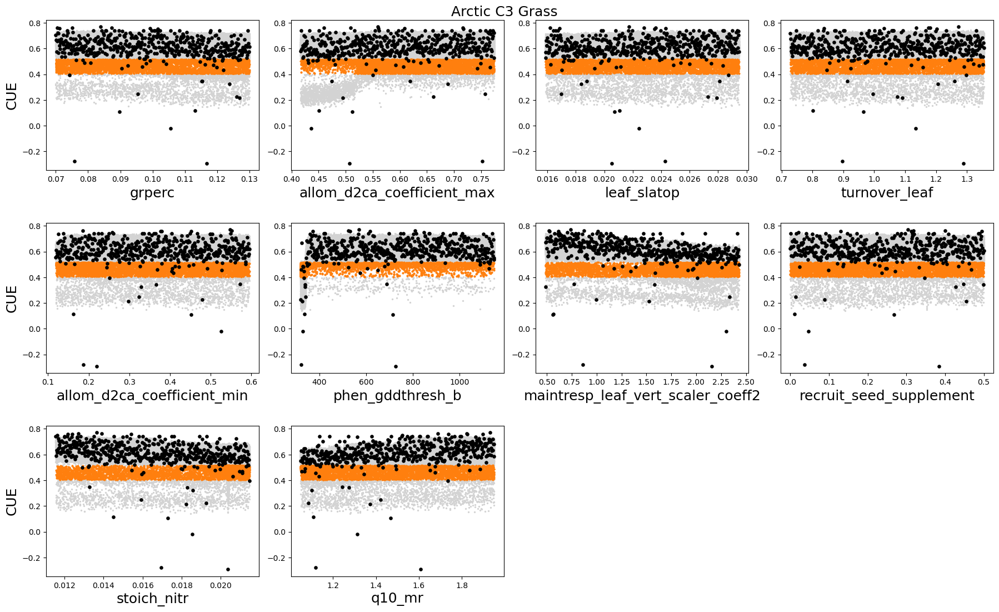

ip 5 9
limxmn 0.25089210271835327 2.0364866256713867
ypred 0.9460500210523606 1.6457980322837829
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_LAI_p9.png


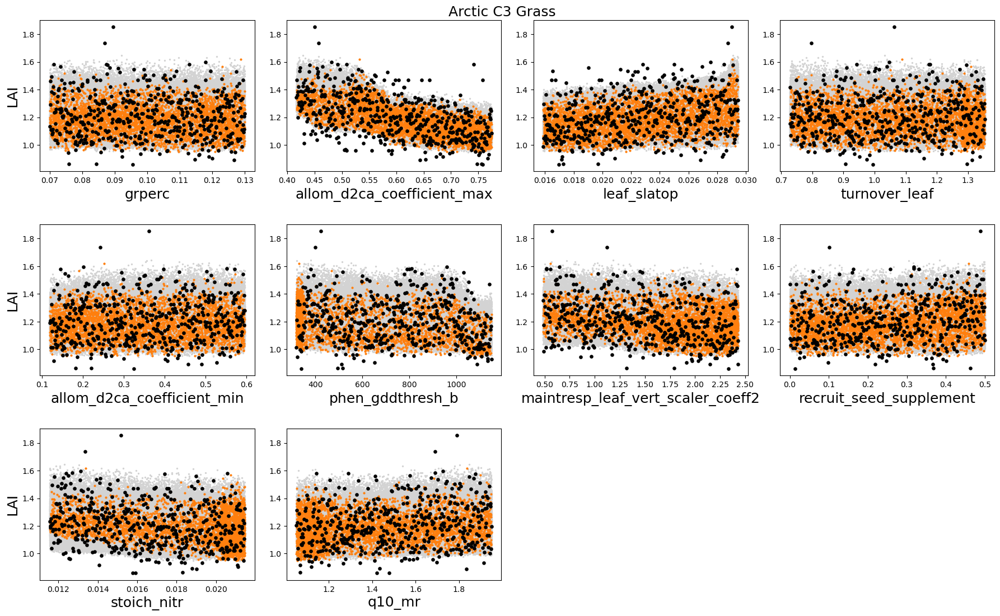

ip 6 10
limxmn 0.25089210271835327 0.7309965491294861
ypred 0.4050919830799103 0.6754626232385635
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_CUE_p10.png


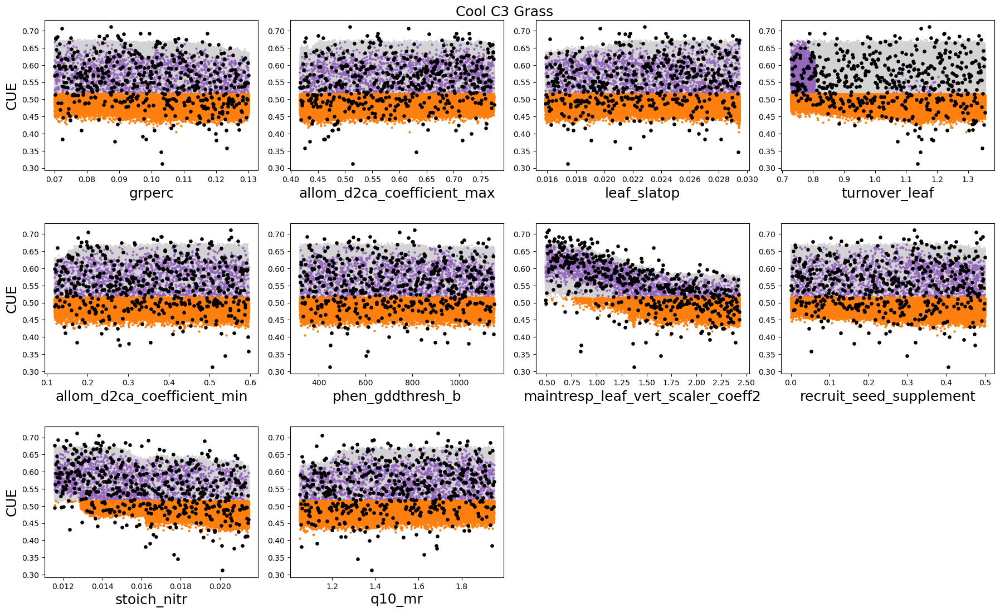

ip 6 10
limxmn 0.25089210271835327 2.0364866256713867
ypred 0.28656756490468976 2.015972249507904
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_LAI_p10.png


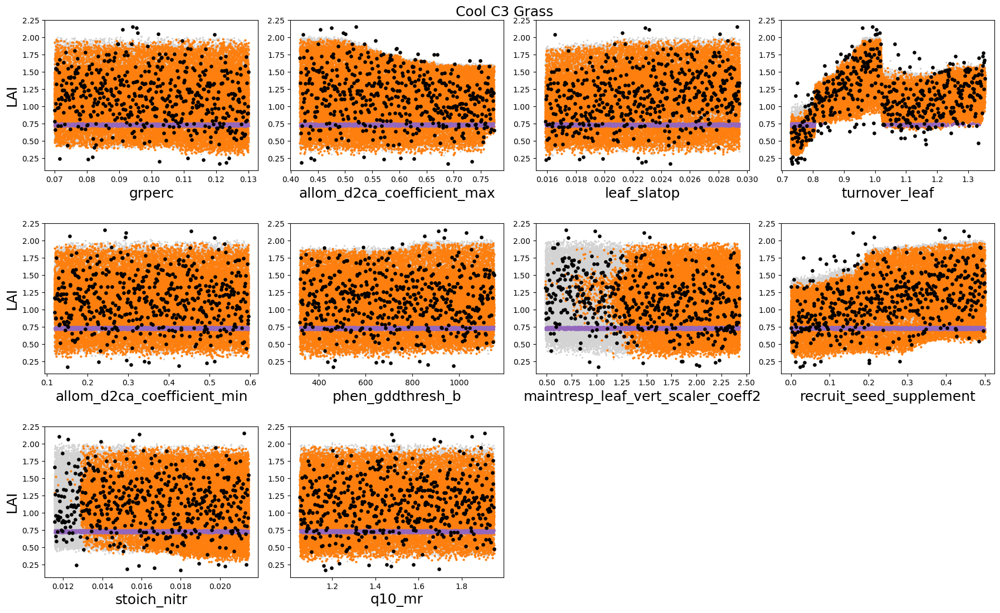

ip 7 11
limxmn 0.25089210271835327 0.7309965491294861
ypred 0.39650395572185515 0.6825797367095947
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_CUE_p11.png


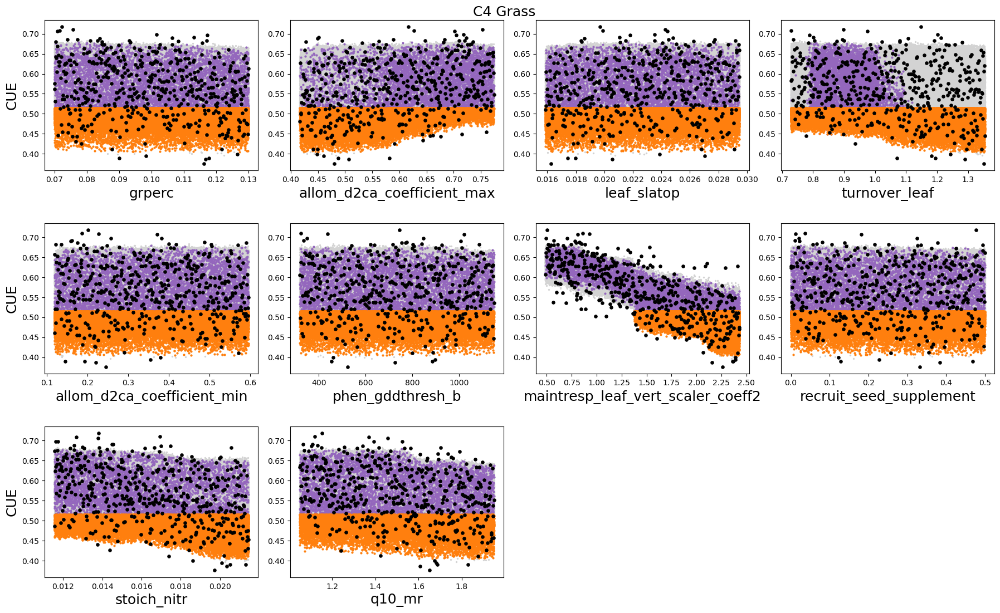

ip 7 11
limxmn 0.25089210271835327 2.0364866256713867
ypred 0.9018123835325241 2.423457273244858
/glade/u/home/rfisher/rosiefork_fates_global_cal/rosie_ppe/gaussian_emulator/figs_FATES_NOCOMP_FBG_PPE_LHC10_//emulator_and_ensemble_10_LAI_p11.png


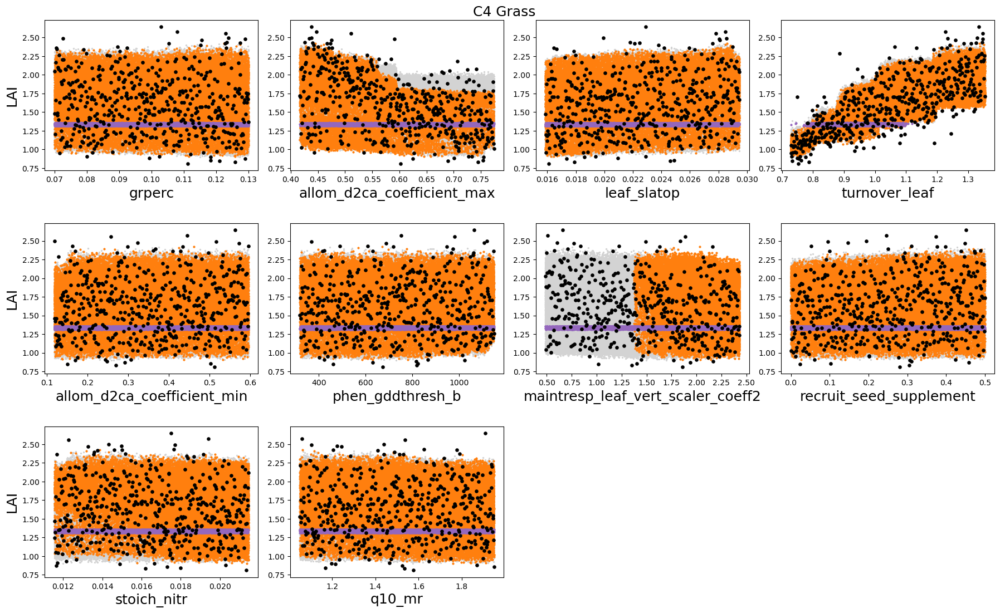

26 0


TypeError: draw_selected_param_space() missing 1 required positional argument: 'vtoggle'

In [57]:

from matplotlib.colors import CSS4_COLORS

colors = plt.get_cmap('tab10').colors
# Choosing a specific color from the CSS4_COLORS dictionary
chosen_color_all = CSS4_COLORS['lightgrey']  # Selecting the 'lightblue' color from the CSS4_COLORS dictionary
chosen_color_cue = CSS4_COLORS['goldenrod']  # Selecting the 'lightblue' color from the CSS4_COLORS dictionary
chosen_color_lai = CSS4_COLORS['darkcyan']  # Selecting the 'lightblue' color from the CSS4_COLORS dictionary
chosen_color_ens = CSS4_COLORS['darkblue']  # Selecting the 'lightblue' color from the CSS4_COLORS dictionary

#chosen_color_all = colors[0]  # Selecting the 'lightblue' color from the CSS4_COLORS dictionary
chosen_color_cue = colors[1]   # Selecting the 'lightblue' color from the CSS4_COLORS dictionary
chosen_color_lai = colors[4]   # Selecting the 'lightblue' color from the CSS4_COLORS dictionary
chosen_color_ens = colors[5]  # Selecting the 'lightblue' color from the CSS4_COLORS dictionary

if pftfit==1:
    for i in range(len(pfts)):
        for vtoggle in [0,1]:
            p = pfts[i]
            gcells=gcells_pft[p]
            print('ip',i,p)
            draw_selected_param_space(i,p,pftfit,vtoggle)   
    
            figname=figdir+'/emulator_and_ensemble_'+str(ensN)+'_'+vars_bm[vtoggle]+'_p'+str(p)+'.png'
            print(figname)
            plt.savefig(figname, bbox_inches='tight')
            plt.show() 
    else:
        for i in range(len(gcells_pft[p])):
            g=gcells[i] 
            print(g,i)
            draw_selected_param_space(g,i,pftfit)


### Make plot of 3D parameter space

(8320,)
(16821,)
0.02946657599939555 0.029466666666666665 0.029465941328497745


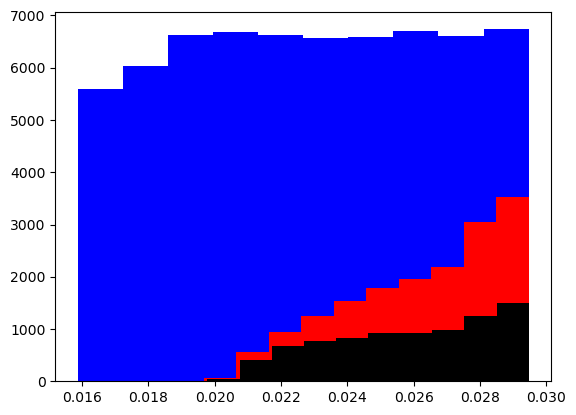

In [48]:
i=0
accept_lai=accept_lai_i[i]
accept_cue=accept_cue_i[i]   
common_values = np.intersect1d(accept_lai, accept_cue)
print(np.shape(common_values))
p=0
xv=feat_importance[p,0,1]
xsl=np.squeeze( Xdense[accept_lai,xv])
xsc=np.squeeze( Xdense[accept_cue,xv])
xscv=np.squeeze( Xdense[common_values,xv])
print(np.shape(xsl))
plt.hist(xsc,color='blue')
plt.hist(xsl,color='red')
plt.hist(xscv,color='black')
print(np.max(xsl),np.max(xsc),np.max(xscv))

(16821,)
0.5953973884732121 0.5954704333333334 0.5953624539748932


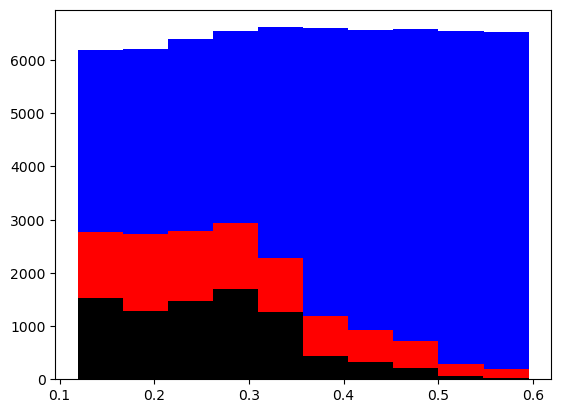

In [49]:
zv=feat_importance[p,2,1]
zsl=np.squeeze( Xdense[accept_lai,zv])
zsc=np.squeeze( Xdense[accept_cue,zv])
zscv=np.squeeze( Xdense[common_values,zv])
print(np.shape(xsl))
plt.hist(zsc,color='blue')
plt.hist(zsl,color='red')
plt.hist(zscv,color='black')
print(np.max(zsl),np.max(zsc),np.max(zscv))

(16821,)
2.429675997839986 2.43 2.429675997839986


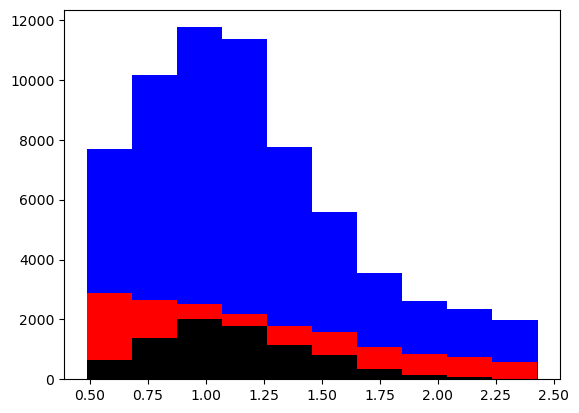

In [50]:
yv=feat_importance[p,1,1]
ysl=np.squeeze( Xdense[accept_lai,yv])
ysc=np.squeeze( Xdense[accept_cue,yv])
yscv=np.squeeze( Xdense[common_values,yv])
print(np.shape(ysl))
plt.hist(ysc,color='blue')
plt.hist(ysl,color='red')
plt.hist(yscv,color='black')
print(np.max(ysl),np.max(ysc),np.max(yscv))

In [58]:
def plot_3d_param_space(i,g,axes,row,col,v):
    accept_lai=accept_lai_i[i]
    accept_cue=accept_cue_i[i]   
    common_values = np.intersect1d(accept_lai, accept_cue)
    if(v==2):
        vf=1
    else:
        vf=v
        
    xv=feat_importance[i,0,vf]
    yv=feat_importance[i,1,vf]
    zv=feat_importance[i,2,vf]
    cv=feat_importance[i,3,vf]

    xsl = Xdense[accept_lai,xv]
    ysl = Xdense[accept_lai,yv]
    zsl = Xdense[accept_lai,zv]
    csl = Xdense[accept_lai,cv]
    
    xsc = Xdense[accept_cue,xv]
    ysc = Xdense[accept_cue,yv]
    zsc = Xdense[accept_cue,zv]
    csc = Xdense[accept_cue,cv]

    xsb = Xdense[common_values,xv]
    ysb = Xdense[common_values,yv]
    zsb = Xdense[common_values,zv]
    csb = Xdense[common_values,cv]
    if np.size(ysb>0):
        print('max lai,cue,common x',np.max(xsl),np.max(xsc),np.max(xsb))
        print('max lai,cue,common y',np.max(ysl),np.max(ysc),np.max(ysb))
        print('max lai,cue,common z',np.max(zsl),np.max(zsc),np.max(zsb))
    if(i==0):
        print('blt zvals',np.shape(zsl),np.squeeze(zsl)[1:10])
        
    xsd = Xdense[:,xv]
    ysd = Xdense[:,yv]
    zsd = Xdense[:,zv]

    plt3d=axes[row,col].scatter(xsd, ysd, zsd, s=1,color=chosen_color_all, alpha=0.05)
    if(v==1): # LAI
        plt3d=axes[row,col].scatter(xsl,  ysl,  zsl,  s=8,c=chosen_color_lai, alpha=1,label='LAI constraint')
        if(i==0):
            pltz=axes[row,col].text(0.05,2,0.4,str(np.max(zsl)))#plt3dc=axes[row,col].scatter(xsc,  ysc,  zsc,  s=8,c=chosen_color_cue, alpha=0.7,label='CUE constraint')
    elif v==0:
        plt3d=axes[row,col].scatter(xsc,  ysc,  zsc,  s=8,c=chosen_color_cue, alpha=1,label='CUE constraint')
        #plt3dl=axes[row,col].scatter(xsl,  ysl,  zsl,  s=8,c=chosen_color_lai, alpha=0.7,label='LAI constraint')

    elif v==2:
        plt3d=axes[row,col].scatter(xsb,  ysb,  zsb,  s=8,c='black', alpha=0.7,label='CUE and LAI constraint')
        #plt3dl=axes[row,col].scatter(xsl,  ysl,  zsl,  s=8,c=chosen_color_lai, alpha=0.7,label='LAI constraint')
    
    fsa=24
    fst=26
    axes[row,col].set_xlabel(lhc_vars_title[xv],fontsize=fsa)
    axes[row,col].set_ylabel(lhc_vars_title[yv],fontsize=fsa)
    axes[row,col].set_zlabel(lhc_vars_title[zv],fontsize=fsa)
    axes[row,col].set_title(pftname,fontsize=fst)   

    return [plt3d]

### Plot the 3D space for each PFT average calibration

3 3
0
max lai,cue,common x 2.429675997839986 2.43 2.429675997839986
max lai,cue,common y 0.021460044177930633 0.02146044038063199 0.021460044177930633
max lai,cue,common z 0.4999899999333329 0.5 0.49993999959999735
blt zvals (1, 16821) [0.03723358 0.3850759  0.49334996 0.49161328 0.44742632 0.43745625
 0.08661724 0.33247888 0.13508423]
1
max lai,cue,common x 2.429974079827199 2.43 2.429909279395196
max lai,cue,common y 0.02146070451576622 0.02146070451576622 0.02146070451576622
max lai,cue,common z 1.9499819998799994 1.9500000000000002 1.949945999639998
2
max lai,cue,common x 2.429974079827199 2.4299870399135997 2.429974079827199
max lai,cue,common y 1.9500000000000002 1.9499819998799994 1.9499819998799994
max lai,cue,common z 0.5954640816063663 0.5954291471080474 0.5954291471080474
7
max lai,cue,common x 1.9481339875599173 1.344661964413096 1.0769881799211993
max lai,cue,common y 2.4283799891999283 2.429974079827199 1.974349282328549
max lai,cue,common z 0.01956560096141919 0.02145911

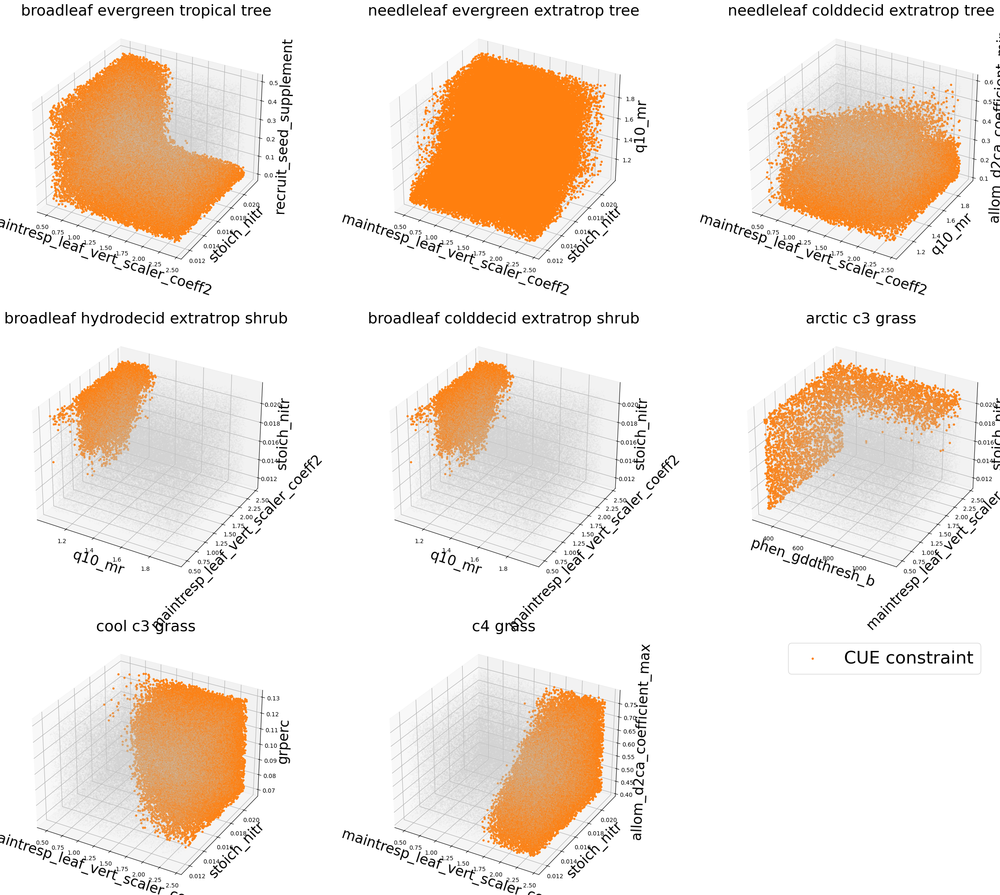

0
max lai,cue,common x 0.02946657599939555 0.029466666666666665 0.029465941328497745
max lai,cue,common y 2.429675997839986 2.43 2.429675997839986
max lai,cue,common z 0.5953973884732121 0.5954704333333334 0.5953624539748932
blt zvals (1, 16821) [0.41382692 0.17413815 0.26824852 0.33989917 0.33371577 0.13376658
 0.25891465 0.47939262 0.46746726]
1
max lai,cue,common x 0.029464853321244364 0.02946657599939555 0.029464853321244364
max lai,cue,common y 0.5954672574698499 0.5954704333333334 0.5954672574698499
max lai,cue,common z 0.02146070451576622 0.02146070451576622 0.02146070451576622
2
max lai,cue,common x 0.5954640816063663 0.5954291471080474 0.5954291471080474
max lai,cue,common y 0.029466666666666665 0.02946603199576886 0.029465759993955516
max lai,cue,common z 1148.3668237788252 1148.3889412596086 1148.3668237788252
7
max lai,cue,common x 352.9613917426116 1148.3668237788252 351.6730484869899
max lai,cue,common y 1.9481339875599173 1.344661964413096 1.0769881799211993
max lai,cue,

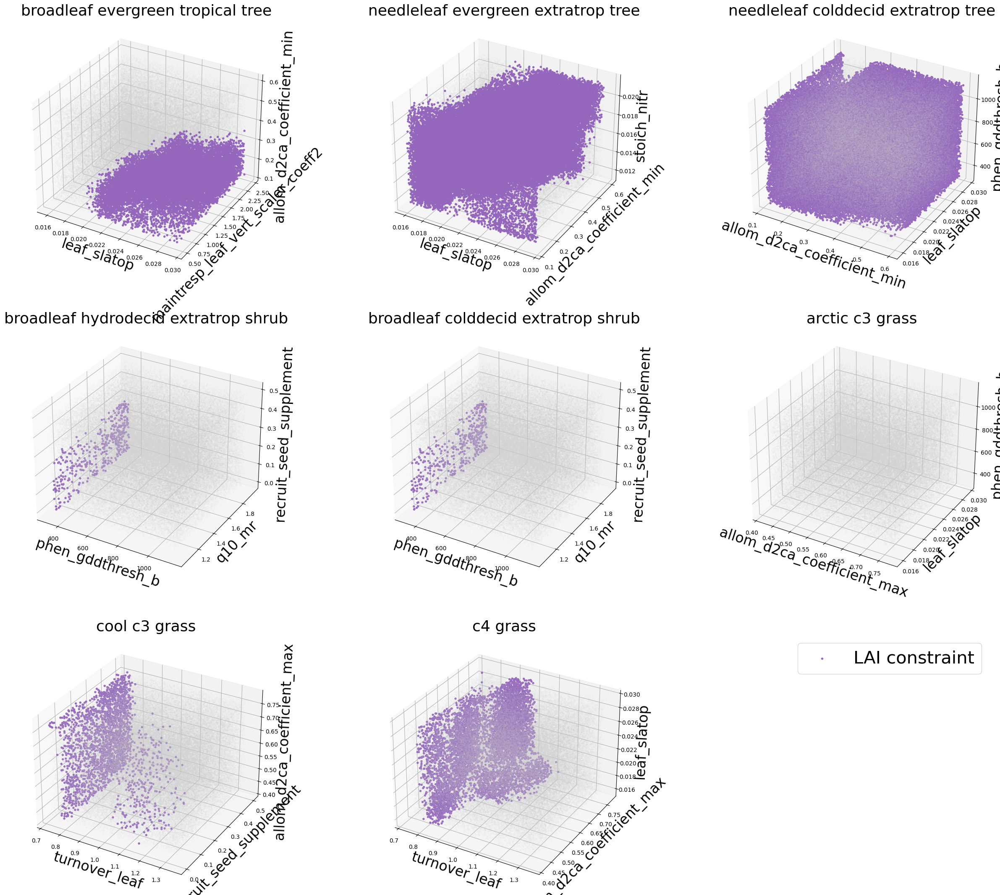

0
max lai,cue,common x 0.02946657599939555 0.029466666666666665 0.029465941328497745
max lai,cue,common y 2.429675997839986 2.43 2.429675997839986
max lai,cue,common z 0.5953973884732121 0.5954704333333334 0.5953624539748932
blt zvals (1, 16821) [0.41382692 0.17413815 0.26824852 0.33989917 0.33371577 0.13376658
 0.25891465 0.47939262 0.46746726]
1
max lai,cue,common x 0.029464853321244364 0.02946657599939555 0.029464853321244364
max lai,cue,common y 0.5954672574698499 0.5954704333333334 0.5954672574698499
max lai,cue,common z 0.02146070451576622 0.02146070451576622 0.02146070451576622
2
max lai,cue,common x 0.5954640816063663 0.5954291471080474 0.5954291471080474
max lai,cue,common y 0.029466666666666665 0.02946603199576886 0.029465759993955516
max lai,cue,common z 1148.3668237788252 1148.3889412596086 1148.3668237788252
7
max lai,cue,common x 352.9613917426116 1148.3668237788252 351.6730484869899
max lai,cue,common y 1.9481339875599173 1.344661964413096 1.0769881799211993
max lai,cue,

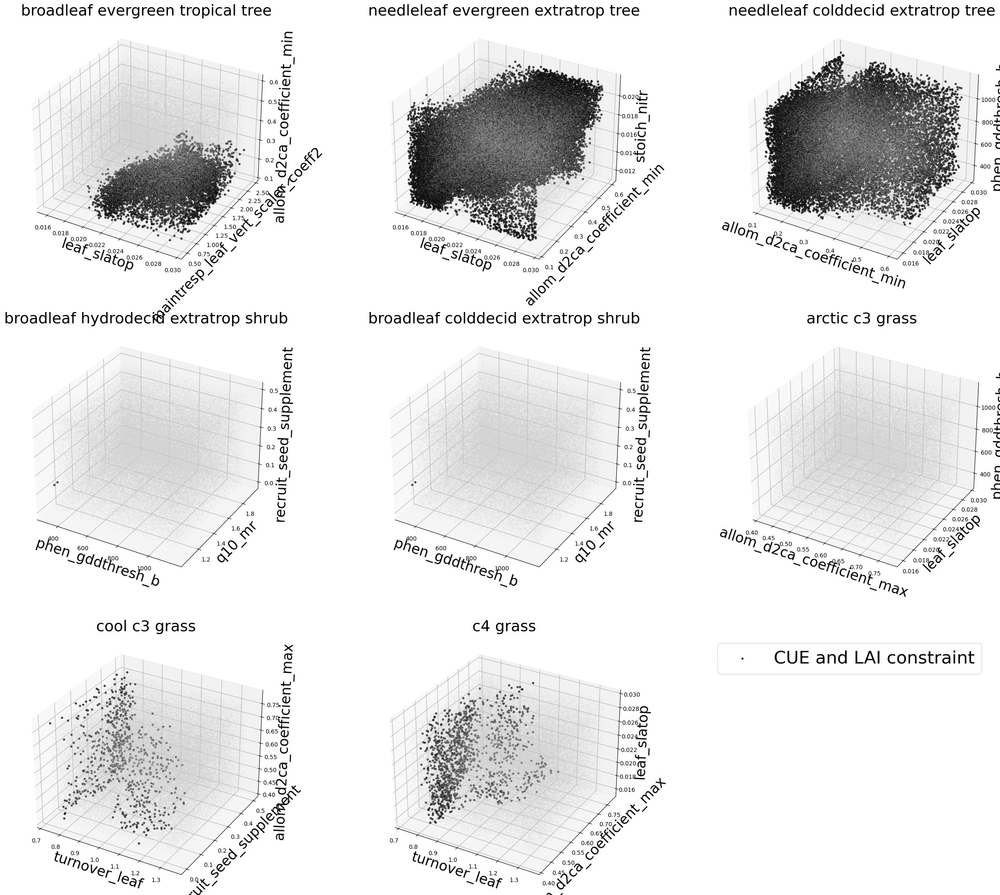

In [59]:
ncls=ncls_pft
rw=int(len(pfts)/ncls)+1
print(ncls,rw)
for v in [0,1,2]:
    fig, axes = plt.subplots(nrows=rw, ncols=ncls, figsize=(32,27),subplot_kw=dict(projection='3d'))
    plt.subplots_adjust(wspace=0.1, hspace=0.2)

    if(pftfit==1):
        axcount=0
        for i in range(len(pfts)):      
            p=pfts[i] 
            print(p) 
            pftname=sg_data['pft'].values[p]
            row = i //ncls
            col = i % ncls    
            hnd=plot_3d_param_space(i,p, axes, row, col,v)
            axcount=axcount+1
            
    axes[ncls-1, rw-1].legend(handles=hnd,fontsize=30)  # Place the legend in the upper right corner            
    axes[ncls-1, rw-1].axis('off')

 #   while axcount < rw*ncls:
 #       row = axcount //ncls
 #       col = axcount %ncls
 #       axes[row, col].remove()
 #       axcount += 1  
    plt.show()

In [53]:
  
    plt.tight_layout()
    plt.savefig(figdir+'/PFT_3D_plot_e'+str(ensN)+'.png', bbox_inches='tight')
    plt.show()

<Figure size 640x480 with 0 Axes>

In [54]:
for i in range(len(gcells)):
    g=gcells[i] 
    row = i //ncls
    col = i % ncls    
    plot_3d_param_space(g, axes, row, col)
while axcount < rw*ncls:
    row = axcount //ncls
    col = axcount %ncls
    axes[row, col].remove()
    axcount += 1
plt.savefig(figdir+'/PFT_3D_plot_e'+str(ensN)+'_'+fatesvar+'_p'+'.png', bbox_inches='tight')
plt.show()

TypeError: plot_3d_param_space() missing 2 required positional arguments: 'col' and 'v'

In [ ]:
ncls=3
rw=int(len(gcells)/ncls)+1
print(rw)
fig, axes = plt.subplots(nrows=rw, ncols=ncls, figsize=(22, 24))
plt.subplots_adjust(wspace=0.1, hspace=0.28)
multp=1
rf_models = []
rf_st=np.zeros(max(pfts))
axcount=0
for p in pfts:
    row = axcount //ncls
    col = axcount % ncls   
    axcount=axcount+1
    random_forest(gcells_pft[p],1,1, axes, row, col,multp)
    axes[row,col].set_xlabel(fatesvar+' process model',fontsize=16)
    axes[row,col].set_ylabel(fatesvar+' surrogate',fontsize=16)
    axes[row,col].set_title(sg_data['pft'].values[p].title(),fontsize=16)



plt.savefig(figdir+'/PFT_level_RF_fit_'+fatesvar+'_y'+str(ychoose)+'Nens_'+str(ensN)+'.png',bbox_inches='tight')  
plt.show()

### Make jupyter book

In [ ]:
help(jb)

In [ ]:
jb setup

### Make map pf relative skill of emulator

In [ ]:
def get_map(da,sgmap=None):
    if not sgmap:
        sgmap=xr.open_dataset(sgpath)
    return da.sel(gridcell=sgmap.cclass).where(sgmap.notnan).compute()
    

In [ ]:
sgvar=l.FATES_LAI[0,:]
sgpath='../output_nocomp_ensemble_python/sgmap.nc'
sgvar[0:355]=lr_st[0:355]
sgvar[356:400]=0

mapped_var=np.flip(get_map(sgvar))
plt.imshow(np.flip(mapped_var,1),clim=[0,1] )                                    
colorbar = plt.colorbar( shrink=0.7)
filename=figdir+'/skillmap_lr_'+str(ensN)+'_'+fatesvar+'.png'
print(filename)
plt.text(10, 85, 'Linear Regression R$^{2}$')
plt.savefig(filename)  



In [ ]:
sgpath='../output_nocomp_ensemble_python/sgmap.nc'
sgvar[0:355]=rf_st[0:355]
sgvar[356:400]=0

mapped_var=np.flip(get_map(sgvar))
plt.imshow(np.flip(mapped_var,1),clim=[0,1                                     ])
colorbar = plt.colorbar( shrink=0.7)
filename=figdir+'/skillmap_rf_'+str(ensN)+'_'+fatesvar+'.png'
print(filename)
plt.text(10, 85, 'Random Forest R$^{2}$')
plt.savefig(filename)  

